In this notebook results from the benchmarking och the simulated dataset 100x is displayed. 

In [9]:
import ruptures as rpt
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import pybedtools
import time

In [1]:
def calculate_avg_thr(path):
    avg_thr=[]
    data=pd.read_csv(path, header=None, sep='\t')
    #Extract the individual sample
    for i in range(len(data.columns)-2):
        curr_array=np.array(data[i+2])
        curr_array[curr_array > 150] = 150
        (n, bins, patches)=plt.hist(curr_array, bins=150)
        max_value=(np.max(n[4:]))
        max_index = np.where(n == max_value)
        avg=bins[max_index]
        avg_thr.append(avg)
    return avg_thr


#Creates a bed file from an array
def create_bed_from_array(array, chr_name):

    data_array = []
    if len(array) % 2 != 0:
        array=array[:-1] #Remove last value
    for i in range(0, len(array), 2):
        data_array.append([chr_name, array[i],array[i+1]])
    np_array = np.array(data_array)
    dataframe = pd.DataFrame(np_array)
    return pybedtools.BedTool.from_dataframe(dataframe)


#Removes matches with a 60% match
def remove_artifacts(ref_bed, ind_bed):
    ind5_bkps_bed = pybedtools.BedTool(ind_bed)
    ref_bkps_bed = pybedtools.BedTool(ref_bed)
    return ind5_bkps_bed.subtract(ref_bkps_bed, f=0.6, r=True, A=True )#

def bed_to_array(bed):
    return pybedtools.BedTool.to_dataframe(bed).loc[:, ["start", "end"]].to_numpy().flatten()

def filter_coverage(pred_array, coverage_array, threshold):
    pred_filterd=[]
    for i in range(len(pred_array)-1):
        start=pred_array[i]
        stop=pred_array[i+1]
        temp=coverage_array[start: stop]
        avg_coverage=sum(temp)/len(temp)
       
        if avg_coverage<threshold:
            pred_filterd.extend([start, stop])
    return pred_filterd

#Creates an info array about the predicted change points
def create_info_array(bedObject):
        info=[]
        for feature in bedObject:
            info.append(feature.stop-feature.start)
        min_info=np.min(info)
        max_info=np.max(info)
        avg_info=np.mean(info)
        len_info=len(info)
        (n, bins, patches)=plt.hist(info)
        plt.xlabel('Size of deletion')
        plt.ylabel('Number of deletions')
        plt.title('Identified deletions')
        plt.show()

        return min_info, max_info, avg_info, len_info, n, bins



In [2]:
#Calculates the changepoints
def predict_deletions_bottomUp(path, chr_name, pen_ref, pen_ind, arr_avg_cov, ref_index,name, sample_index='all'):

    #Read in the data
    data=pd.read_csv(path, header=None, sep='\t')

    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"
    min_size=100

    #Extract the reference
    all_ref=[]

    #Iterate over all references
    for index in ref_index:
        threshold=arr_avg_cov[index-2]*0.35
        avg_cutoff=arr_avg_cov[index-2]*3
        reference=np.array(data[index])
        reference[reference > avg_cutoff] = avg_cutoff
        t0 = time.time()
        algo_ref = rpt.BottomUp(model=model, min_size=min_size).fit(reference)
        ref_bkps = algo_ref.predict(pen=pen_ref)
        t1 = time.time()
        
    
        filter_array_ref=filter_coverage(ref_bkps, reference, threshold) #Filter the reference
        all_ref.extend(filter_array_ref)
        
        rpt.display(reference, filter_array_ref, figsize=(100, 6))
        plt.title('Reference ' + str(index))
        plt.xlabel('Position')
        plt.ylabel('Coverage')
        plt.xticks(np.arange(0, len(reference)+1, 100000))
        plt.show()
     #   plt.savefig('results_benchmarking/reference_'+ str(index) + name+'.png')

    ref_bed=create_bed_from_array(all_ref, chr_name) #create bed file and save it
    ref_bed_sort=ref_bed.sort().merge().saveas("results_benchmarking/reference_"+name+".bed")

    #Extract the individual sample
    if sample_index=='all': #If 'all' is specifed, the predictions will be done for all columns
        sample_index=range(2, len(data.columns))

    for i in sample_index:

        if i not in ref_index:
            threshold=arr_avg_cov[i-2]*0.15
            avg_cutoff=arr_avg_cov[i-2]*3
            individual=np.array(data[i])
            individual[individual > avg_cutoff] =avg_cutoff

            #Fit the data
            t0 = time.time()
            algo = rpt.BottomUp(model=model, min_size=min_size).fit(individual)

            #Predict the breakpoints for the individual and reference
            ind_bkps = algo.predict(pen=pen_ind)
            t1 = time.time()
            print("Sample:" + str(i) + ', running time: ')
            print(t1-t0)

            
            #filter the sample
            filter_array=filter_coverage(ind_bkps, individual,threshold)
            rpt.display(individual, filter_array, figsize=(100, 6))
            plt.title('Sample ' + str(i))
            plt.xlabel('Position')
            plt.ylabel('Coverage')
            plt.xticks(np.arange(0, len(individual)+1, 100000))
            plt.show()

            pred_filtred_bed=create_bed_from_array(filter_array, chr_name) #create bed file

           # Remove artifacts from reference
            rem_bed=remove_artifacts(ref_bed_sort,pred_filtred_bed).saveas("results_benchmarking/sample_" + str(i) + "_"+name+".bed") # save it
            
          
            #roc_curve(12.5, ind_bkps, true_bkps_bed, individual_12_5x, ref_bkps, 1000000)
            display_over_under_est(true_bkps_dict[str(i)], rem_bed, 1000000)
            
            
            

In [3]:
#Calculates the changepoints
def predict_deletions_window(path, chr_name, pen_ref, pen_ind,width,  arr_avg_cov, ref_index,name, sample_index='all'):

    #Read in the data
    data=pd.read_csv(path, header=None, sep='\t')

    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"
    min_size=100

    #Extract the reference
    all_ref=[]

    #Iterate over all references
    for index in ref_index:
        threshold=arr_avg_cov[index-2]*0.75
        avg_cutoff=arr_avg_cov[index-2]*3
        reference=np.array(data[index])
        reference[reference > avg_cutoff] = avg_cutoff
        t0 = time.time()
        algo_ref = rpt.Window(width=width, model=model, min_size=min_size).fit(reference)
        ref_bkps = algo_ref.predict(pen=pen_ref)
        t1 = time.time()
        
    
        filter_array_ref=filter_coverage(ref_bkps, reference, threshold) #Filter the reference
        all_ref.extend(filter_array_ref)
        
        rpt.display(reference, filter_array_ref, figsize=(100, 6))
        plt.title('Reference ' + str(index))
        plt.xlabel('Position')
        plt.ylabel('Coverage')
        plt.xticks(np.arange(0, len(reference)+1, 100000))
        plt.show()
     #   plt.savefig('results_benchmarking/reference_'+ str(index) + name+'.png')

    ref_bed=create_bed_from_array(all_ref, chr_name) #create bed file and save it
    ref_bed_sort=ref_bed.sort().merge().saveas("results_benchmarking/reference_"+name+".bed")

    #Extract the individual sample
    if sample_index=='all': #If 'all' is specifed, the predictions will be done for all columns
        sample_index=range(2, len(data.columns))

    for i in sample_index:

        if i not in ref_index:
            threshold=arr_avg_cov[i-2]*0.75
            print(threshold)
            avg_cutoff=arr_avg_cov[i-2]*3
            individual=np.array(data[i])
            individual[individual > avg_cutoff] =avg_cutoff

            #Fit the data
            t0 = time.time()
            algo = rpt.Window(width=width,model=model, min_size=min_size).fit(individual)

            #Predict the breakpoints for the individual and reference
            ind_bkps = algo.predict(pen=pen_ind)
            t1 = time.time()
            print("Sample:" + str(i) + ', running time: ')
            print(t1-t0)

            
            #filter the sample
            filter_array=filter_coverage(ind_bkps, individual,threshold)
            rpt.display(individual, filter_array, figsize=(100, 6))
            plt.title('Sample ' + str(i))
            plt.xlabel('Position')
            plt.ylabel('Coverage')
            plt.xticks(np.arange(0, len(individual)+1, 100000))
            plt.show()

            pred_filtred_bed=create_bed_from_array(filter_array, chr_name) #create bed file

           # Remove artifacts from reference
            rem_bed=remove_artifacts(ref_bed_sort,pred_filtred_bed).saveas("results_benchmarking/sample_" + str(i) + "_"+name+".bed") # save it
            
          
            #roc_curve(12.5, ind_bkps, true_bkps_bed, individual_12_5x, ref_bkps, 1000000)
            display_over_under_est(true_bkps_dict[str(i)], rem_bed, 1000000)
            
            
            

In [4]:
#Calculates the changepoints
def predict_deletions_pelt(path, chr_name, pen_ref, pen_ind,jump,  arr_avg_cov, ref_index,name, sample_index='all'):

    #Read in the data
    data=pd.read_csv(path, header=None, sep='\t')

    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"
    min_size=100

    #Extract the reference
    all_ref=[]

    #Iterate over all references
    for index in ref_index:
        threshold=arr_avg_cov[index-2]*0.35
        avg_cutoff=arr_avg_cov[index-2]*3
        reference=np.array(data[index])
        reference[reference > avg_cutoff] = avg_cutoff
        t0 = time.time()
        algo_ref = rpt.Pelt(model=model, min_size=min_size, jump=jump).fit(reference)
        ref_bkps = algo_ref.predict(pen=pen_ref)
        t1 = time.time()
        
    
        filter_array_ref=filter_coverage(ref_bkps, reference, threshold) #Filter the reference
        all_ref.extend(filter_array_ref)
        
        rpt.display(reference, filter_array_ref, figsize=(100, 6))
        plt.title('Reference ' + str(index))
        plt.xlabel('Position')
        plt.ylabel('Coverage')
        plt.xticks(np.arange(0, len(reference)+1, 100000))
        plt.show()
     #   plt.savefig('results_benchmarking/reference_'+ str(index) + name+'.png')

    ref_bed=create_bed_from_array(all_ref, chr_name) #create bed file and save it
    ref_bed_sort=ref_bed.sort().merge().saveas("results_benchmarking/reference_"+name+".bed")

    #Extract the individual sample
    if sample_index=='all': #If 'all' is specifed, the predictions will be done for all columns
        sample_index=range(2, len(data.columns))

    for i in sample_index:

        if i not in ref_index:
            threshold=arr_avg_cov[i-2]*0.15
            print(threshold)
            avg_cutoff=arr_avg_cov[i-2]*3
            individual=np.array(data[i])
            individual[individual > avg_cutoff] =avg_cutoff

            #Fit the data
            t0 = time.time()
            algo = rpt.Pelt(model=model, min_size=min_size, jump=jump).fit(individual)

            #Predict the breakpoints for the individual and reference
            ind_bkps = algo.predict(pen=pen_ind)
            t1 = time.time()
            print("Sample:" + str(i) + ', running time: ')
            print(t1-t0)

            
            #filter the sample
            filter_array=filter_coverage(ind_bkps, individual,threshold)
            rpt.display(individual, filter_array, figsize=(100, 6))
            plt.title('Sample ' + str(i))
            plt.xlabel('Position')
            plt.ylabel('Coverage')
            plt.xticks(np.arange(0, len(individual)+1, 100000))
            plt.show()

            pred_filtred_bed=create_bed_from_array(filter_array, chr_name) #create bed file

           # Remove artifacts from reference
            rem_bed=remove_artifacts(ref_bed_sort,pred_filtred_bed).saveas("results_benchmarking/sample_" + str(i) + "_"+name+".bed") # save it
            
          
            #roc_curve(12.5, ind_bkps, true_bkps_bed, individual_12_5x, ref_bkps, 1000000)
            display_over_under_est(true_bkps_dict[str(i)], rem_bed, 1000000)
            
            
            

In [5]:
# Make a python function which can compare output from script to the given .bed files and calculate:

# Accuracy = (TP+TN)(/TN+FN+TP+FP)
# Sensitivity (True Positive Rate) = TP/(TP+FN)
# Specificity (True Positive Rate) = TN/(FP+TN)
# ROC-curve

# True Positive - A true deletion (found through script and bed file)
# False Positive - Script find deletion but not in bed file (over estimated)
# True Negative - Icke deletion (interval from deletion to deletion)
# False Negative - Script does not find true deletion (missed sites)

# Find the smallest deletion (true positive with the smallest length)

def calc_acc_sens_spec(pred_bkps_bed, true_bkps_bed, lenght):
   # Compare 2 bed-files or two arrays or matrices
   # pred_bed is from our script
   # true_bed is bed-file with true deletions

   # pred_bkps_bed = pybedtools.BedTool(pred_bed)
   # true_bkps_bed = pybedtools.BedTool(true_bed)

    true_pos_bed= pred_bkps_bed.intersect(true_bkps_bed)
    false_pos_bed=pred_bkps_bed.subtract(true_bkps_bed)

    true_pos_arr=[]
    false_pos_arr=[]
    real_del=[]

    for feature in true_pos_bed:
        true_pos_arr.append(feature.stop-feature.start)
    for feature in false_pos_bed:
        false_pos_arr.append(feature.stop-feature.start)
    for feature in true_bkps_bed:
        real_del.append(feature.stop-feature.start)

   # True positives
    true_pos = sum(true_pos_arr)
   # False positives
    false_pos =  sum(false_pos_arr)
   # False negative
    false_neg = sum(real_del)- sum(true_pos_arr)#Real deletions - true positives
   # True negative
    true_neg = lenght - sum(false_pos_arr) - false_neg - sum(true_pos_arr)


    accuracy = (true_pos + true_neg)/(true_neg + false_neg + true_pos + false_pos)
    sensitivity = true_pos/(true_pos + false_neg)
    specificity = true_neg/(true_neg + false_pos)

    return accuracy, sensitivity, specificity

def over_estimated_sites(true_del, false_pos):
    over_est_sites = []
    real_del=[]
    # Loop through size/number of true deletions
    for i in range(true_del.shape[0]):
        real_del.append(true_del.loc[i,"end"]-true_del.loc[i,"start"])
        left_over_est = 0 # Over estimation to the left of the deletion
        right_over_est = 0 # Over estimation to the right of the deletion
        # Loop through all false positives
        for j in range(false_pos.shape[0]):
            # Left side match
            if false_pos.loc[j,"end"] == true_del.loc[i,"start"]:
                left_over_est = false_pos.loc[j,"end"]-false_pos.loc[j,"start"]
            # Right side match
            elif false_pos.loc[j,"start"] == true_del.loc[i,"end"]:
                right_over_est = false_pos.loc[j,"end"]-false_pos.loc[j,"start"]
        over_est_sites.append(left_over_est + right_over_est) # Append number of over estimated sites

    fractions = [(i / j)*100 for i, j in zip(over_est_sites, real_del)]
    my_labels = {"x1" : "No over estimation", "x2" : "Completly missed", "x3":"Partly over estimated"}

    for k in range(len(fractions)):
        if fractions[k]==0:
            plt.scatter(real_del[k], fractions[k], c="g", label=my_labels["x1"])
            my_labels["x1"] = "_nolegend_"
        elif fractions[k]==-1:
            plt.scatter(real_del[k], fractions[k], c="r", label=my_labels["x2"])
            my_labels["x2"] = "_nolegend_"
        else:
            plt.scatter(real_del[k], fractions[k], c="b", label=my_labels["x3"])
            my_labels["x3"] = "_nolegend_"


    plt.title("Percentage Over Estimated Sites")
    plt.xlabel("Size of deletion")
    plt.ylabel("% over estimated sites")
    plt.legend()
    plt.grid()
    plt.show()
    return fractions

#uses bedfile to dataframe
def under_estimated_sites(true_del, true_pos):
    missed_sites = []
    real_del=[]
    for i in range(true_del.shape[0]):
        real_del.append(true_del.loc[i,"end"]-true_del.loc[i,"start"])
        if true_del.loc[i,"name"]==0:
            missed_sites.append(true_del.loc[i,"end"]-true_del.loc[i,"start"])
        else:
            j = 0
            while true_pos.loc[j,"start"] < true_del.loc[i,"end"]:
                j=j+1
                if j >= true_pos.shape[0]:
                    break
            missed_sites.append(true_pos.loc[j-1,"start"]-true_del.loc[i,"start"] + true_del.loc[i,"end"]-true_pos.loc[j-1,"end"])

    fractions = [(i / j)*100 for i, j in zip(missed_sites, real_del)]
    my_labels = {"x1" : "Completly missed", "x2" : "Nothing missed", "x3":"Partly missed"}

    for k in range(len(fractions)):
        if fractions[k]==100:
            plt.scatter(real_del[k], fractions[k], c="r", label=my_labels["x1"])
            my_labels["x1"] = "_nolegend_"
            
        elif fractions[k]==0:
            plt.scatter(real_del[k], fractions[k], c="g", label=my_labels["x2"])
            my_labels["x2"] = "_nolegend_"
        else:
            plt.scatter(real_del[k], fractions[k], c="b", label=my_labels["x3"])
            my_labels["x3"] = "_nolegend_"
    plt.title("Percentage Under Estimated Sites")
    plt.xlabel("Size of deletion")
    plt.ylabel("% missed sites")
    plt.legend()
    plt.grid()
    plt.show()
    return fractions


def roc_curve(avg_coverage, pred_array, true_del_bed, coverage_array, ref_arr, lenght):

    threshold = np.linspace(0, avg_coverage,70)
    acc_arr = []
    spec_arr = []
    sens_arr = []
    for thr in threshold:
        # filter_arr=filter_coverage(pred_array, thr, coverage_array) #Filter some threshold
        #
        # pred_filtred_bed=create_bed_from_array(filter_arr) #create bed file
        # ref_bed=create_bed_from_array(ref_arr)
        # rem_pred_filter=remove_artifacts_window(ref_bed,pred_filtred_bed)
        rem_pred_filter=pred_breakpoints(ref_arr, pred_array, coverage_array, thr)
        accuracy, sensitivity, specificity  = calc_acc_sens_spec(rem_pred_filter, true_del_bed, lenght)
        acc_arr.append(accuracy)
        spec_arr.append(specificity)
        sens_arr.append(sensitivity)

    # print("Sensitivity: ")
    # print(sens_arr)
    # print("specificity")
    # print(spec_arr)
    # print("accuracy")
    # print(acc_arr)
    plt.figure(1)
    fpr=1-np.array(spec_arr)
    plt.plot(fpr, sens_arr)
    plt.title("ROC curve - coverage filtering thresholds ")
    plt.xlabel("False positive rate")
    plt.ylabel("Sensitivity")
    same=[]
    # returns the unique values, the index of the first occurrence of a value, and the count for each element
    vals, idx_start, count = np.unique(fpr, return_counts=True, return_index=True)
    idx_sort = np.argsort(fpr)
    # splits the indices into separate arrays
    res = np.split(idx_sort, idx_start[1:])
    index=0
    #for p in res:
        #max_p=max(p)
      #  min_p=min(p)
       # if index==0: 
       #     plt.annotate(round(threshold[min_p], 1), xy=(fpr[min_p],sens_arr[min_p]))
       #     index=1
       # else: 
       #     plt.annotate(round(threshold[min_p], 1), xy=(fpr[min_p],sens_arr[min_p]))
        #    index=0
        #else:
           
            #plt.annotate(round(threshold[max_p], 2), xy=(fpr[max_p],sens_arr[max_p])
    plt.grid()
    #plt.plot(threshold, acc_arr)
    plt.show()
    
    
    
def display_over_under_est(true_bkps_bed, rem_pred_filter, length):
    true_del_with_matches_df = true_bkps_bed.intersect(rem_pred_filter, c=True).to_dataframe()
    false_pos_df=rem_pred_filter.subtract(true_bkps_bed).to_dataframe()
    true_pos_df=rem_pred_filter.intersect(true_bkps_bed).to_dataframe()

    #Under estimated
    under_estimated_sites(true_del_with_matches_df, true_pos_df)
    plt.show()
    #Over estimated
    over_estimated_sites(true_del_with_matches_df, false_pos_df)
    plt.show()
    print("accuracy, sensitivity, specificity")
    print(calc_acc_sens_spec(rem_pred_filter, true_bkps_bed, length))


In [7]:
def extract_data(path): 
    data=pd.read_csv(path, header=None, sep='\t')
    #Extract the individual samples
    for col in range(3,len(data.columns)):
        
        individual=np.array(data[col])

    #Extract the reference
    reference=np.array(data[2])
    return individual, reference


#individual_12_5x, reference_12_5x = extract_data('/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/1mil_12_5x', 5) 


In [10]:
path='/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/1mil_100x'
data=pd.read_csv(path, header=None, sep='\t')
reference=np.array(data[2])
#Read the true deletions as a BED file
true_bkps_bed_A = pybedtools.BedTool("/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/true_del_A_1mil.bed")
true_bkps_bed_B = pybedtools.BedTool("/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/true_del_B_1mil.bed")
true_bkps_bed_C = pybedtools.BedTool("/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/true_del_C_1mil.bed")
true_bkps_bed_D = pybedtools.BedTool("/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/true_del_D_1mil.bed")
true_bkps_bed_E = pybedtools.BedTool("/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/true_del_E_1mil.bed")


In [11]:
true_bkps_dict={'3':true_bkps_bed_A, '4': true_bkps_bed_B, '5':true_bkps_bed_C, '6': true_bkps_bed_D, '7':true_bkps_bed_E}

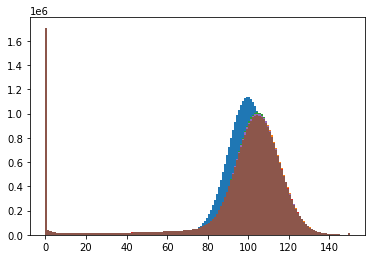

In [14]:
arr_avg_cov=calculate_avg_thr('/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/30mil_sim_100')

In [15]:
print(arr_avg_cov)

[array([99.]), array([104.]), array([104.]), array([104.]), array([104.]), array([104.])]


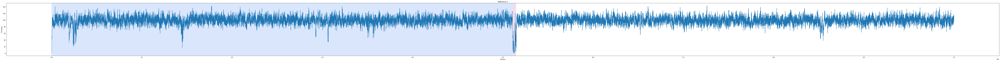

Sample:3, running time: 
6.645816087722778


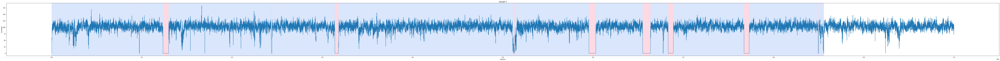

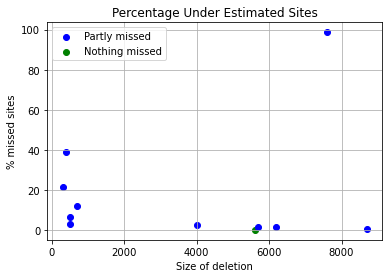

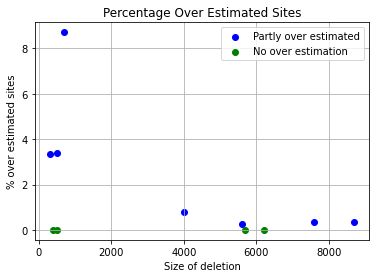

accuracy, sensitivity, specificity
(0.998966, 0.9851492537313433, 0.9995446968118358)
Sample:4, running time: 
6.753790855407715


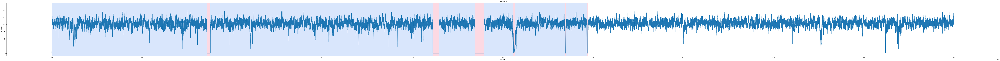

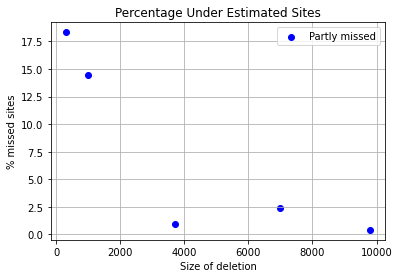

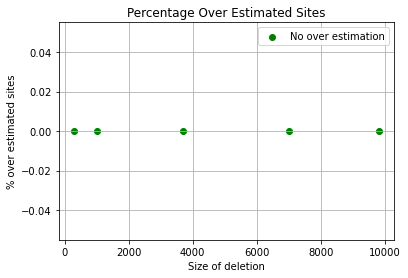

accuracy, sensitivity, specificity
(0.99846, 0.9798165137614679, 0.9988754855857698)
Sample:5, running time: 
6.763160228729248


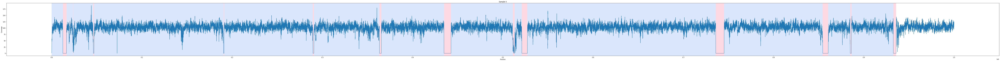

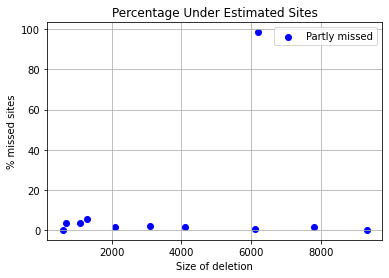

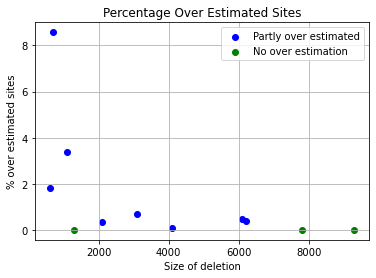

accuracy, sensitivity, specificity
(0.999101, 0.9889858490566038, 0.9995488721804511)
Sample:6, running time: 
6.775385141372681


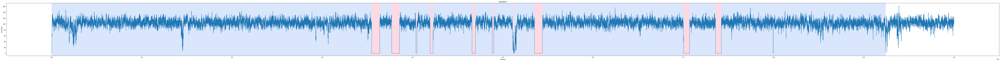

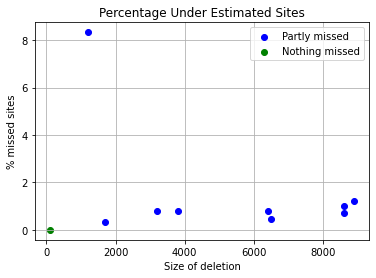

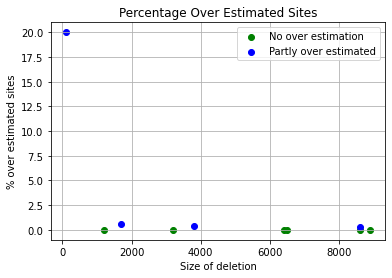

accuracy, sensitivity, specificity
(0.998091, 0.9898571428571429, 0.9985152471083071)
Sample:7, running time: 
6.775038957595825


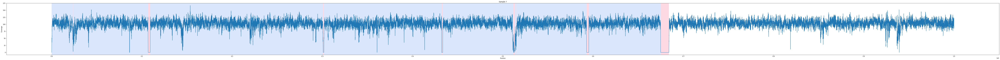

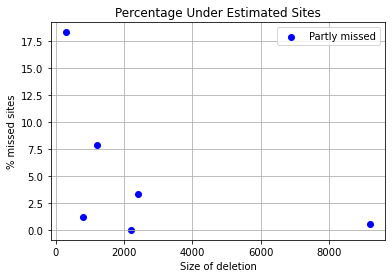

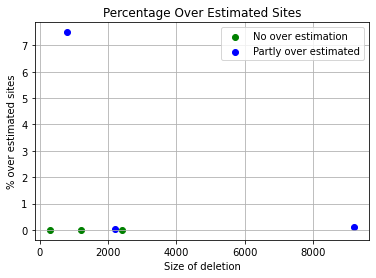

accuracy, sensitivity, specificity
(0.997918, 0.9816149068322981, 0.9981847748754955)


In [16]:
predict_deletions_bottomUp(path, "PA_chr01", 10**4, 10**4, arr_avg_cov,[2], "bu_p10e4")


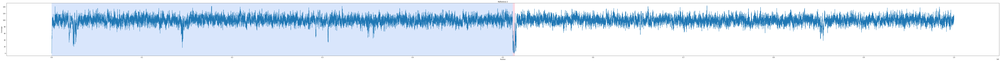

Sample:3, running time: 
7.078804016113281


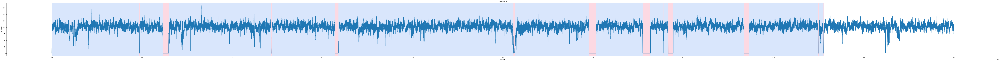

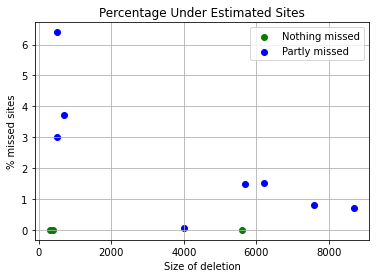

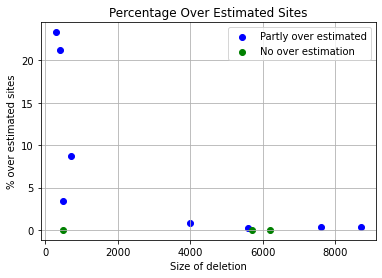

accuracy, sensitivity, specificity
(0.999286, 0.9906218905472637, 0.9996488851844134)
Sample:4, running time: 
6.993278980255127


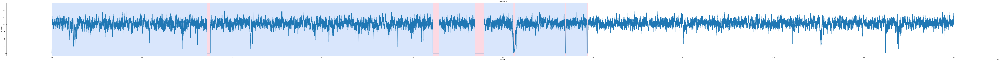

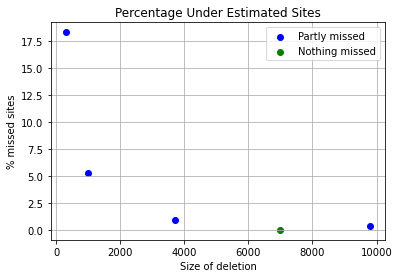

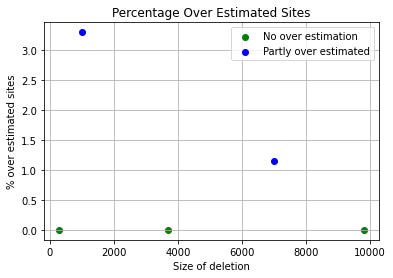

accuracy, sensitivity, specificity
(0.999704, 0.991605504587156, 0.9998844817010836)
Sample:5, running time: 
7.066030979156494


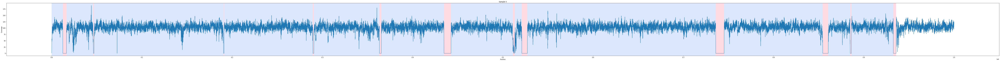

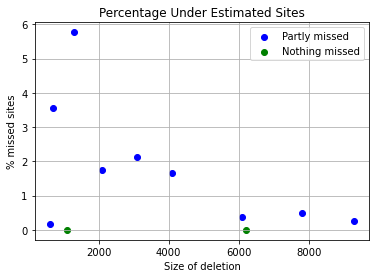

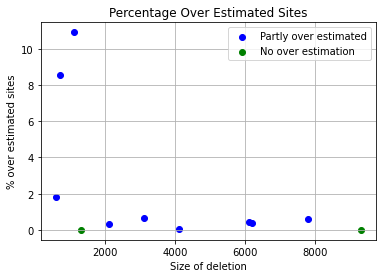

accuracy, sensitivity, specificity
(0.999317, 0.9915330188679246, 0.9996616541353384)
Sample:6, running time: 
7.056507110595703


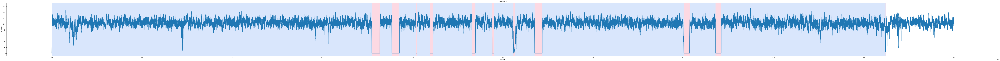

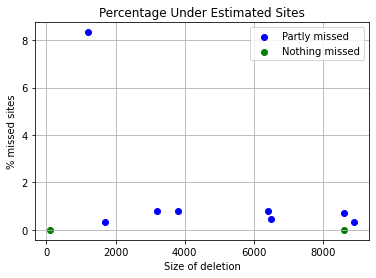

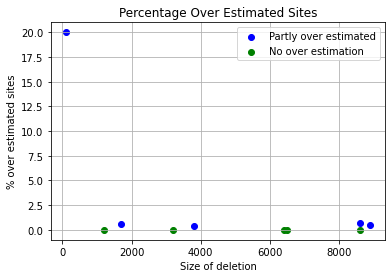

accuracy, sensitivity, specificity
(0.999398, 0.9932448979591837, 0.9997150368033649)
Sample:7, running time: 
7.047548055648804


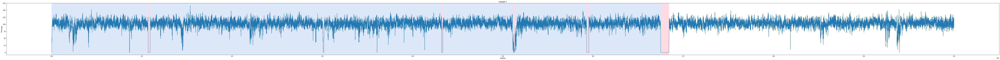

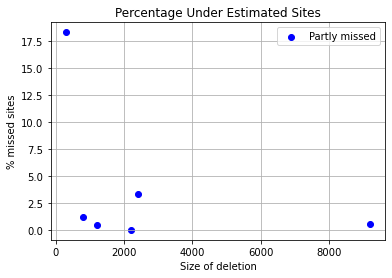

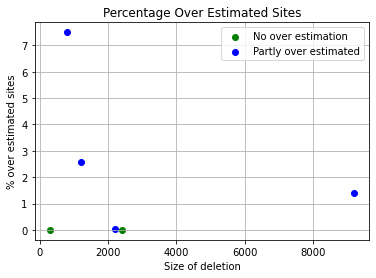

accuracy, sensitivity, specificity
(0.999451, 0.9871428571428571, 0.999652403699563)


In [17]:
predict_deletions_bottomUp(path, "PA_chr01", 10**5, 10**5, arr_avg_cov,[2], "bu_p10e5")


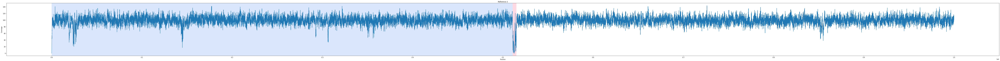

Sample:3, running time: 
7.062628984451294


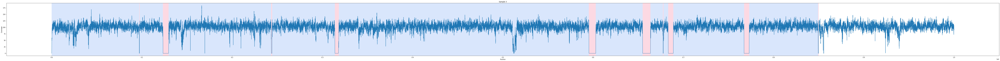

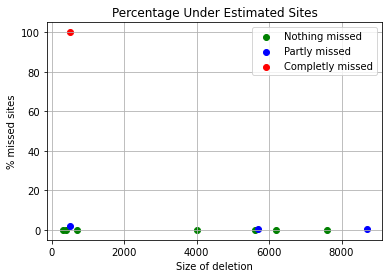

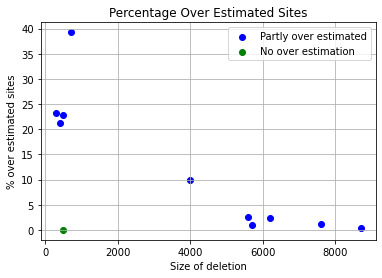

accuracy, sensitivity, specificity
(0.997999, 0.9852487562189055, 0.9985330277141071)
Sample:4, running time: 
7.115309953689575


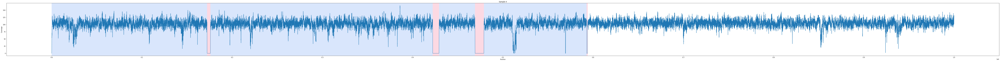

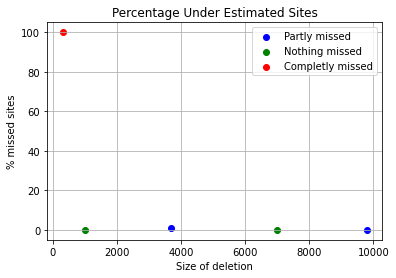

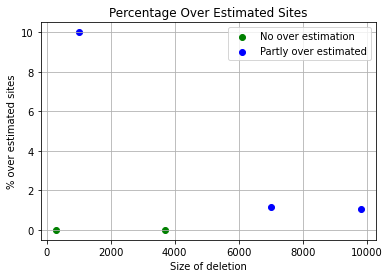

accuracy, sensitivity, specificity
(0.99936, 0.9837155963302753, 0.9997086485381312)
Sample:5, running time: 
7.052159309387207


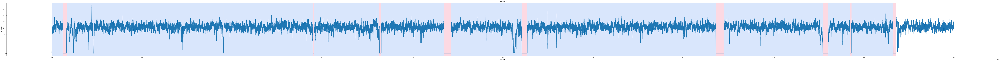

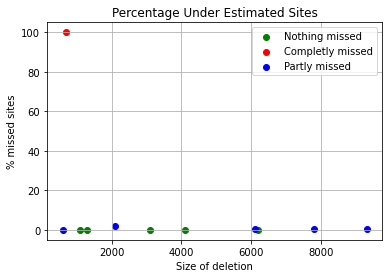

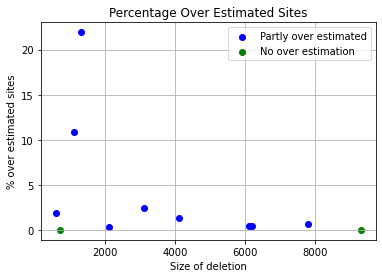

accuracy, sensitivity, specificity
(0.99852, 0.9805424528301887, 0.9993159983291562)
Sample:6, running time: 
7.093425989151001


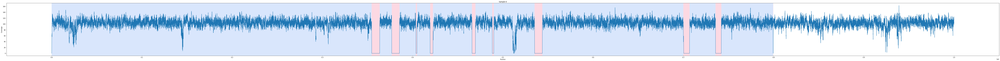

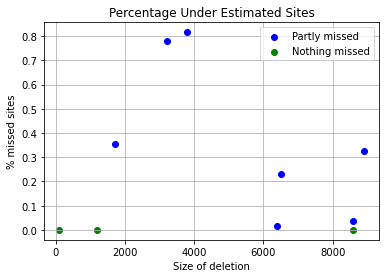

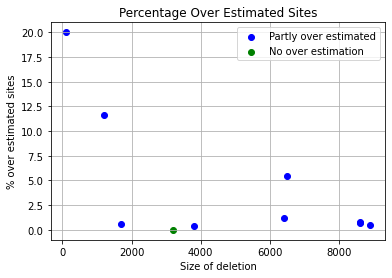

accuracy, sensitivity, specificity
(0.9991, 0.9977551020408163, 0.9991692954784438)
Sample:7, running time: 
7.129405975341797


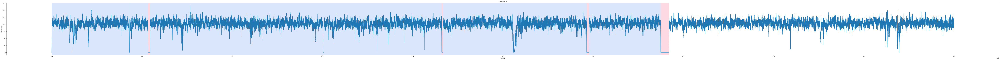

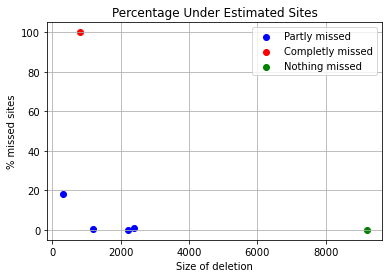

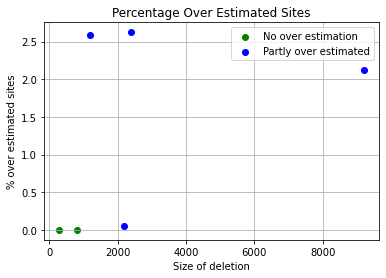

accuracy, sensitivity, specificity
(0.998825, 0.9450310559006211, 0.9997052545990446)


In [18]:
predict_deletions_bottomUp(path, "PA_chr01", 10**6, 10**6, arr_avg_cov,[2], "bu_p10e6")


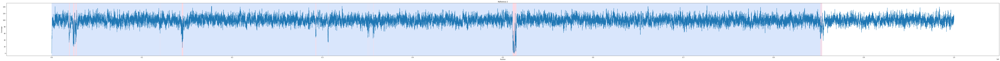

[78.]
Sample:3, running time: 
11.531697988510132


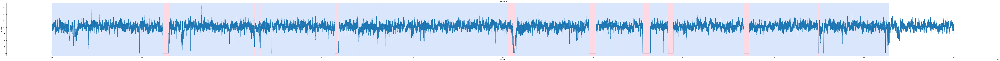

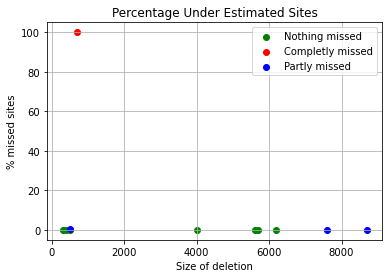

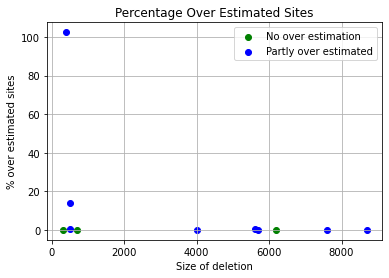

accuracy, sensitivity, specificity
(0.983515, 0.9824626865671642, 0.9835590748072515)
[78.]
Sample:4, running time: 
11.853164672851562


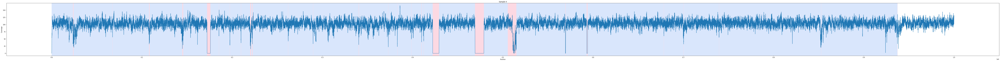

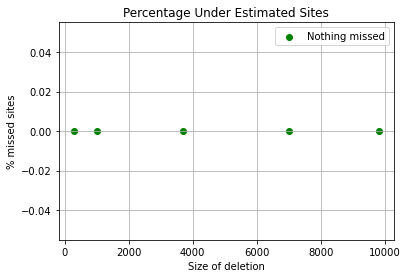

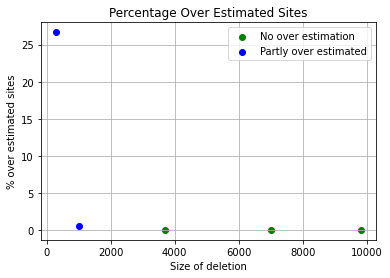

accuracy, sensitivity, specificity
(0.98507, 1.0, 0.9847372725414025)
[78.]
Sample:5, running time: 
13.586204051971436


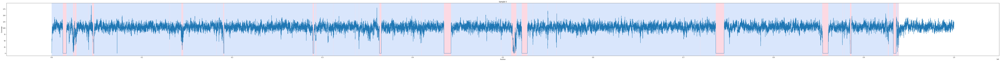

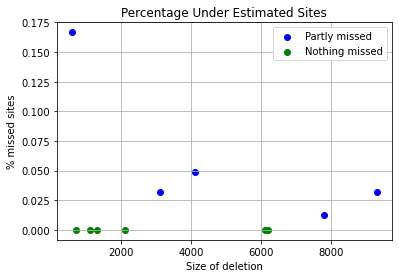

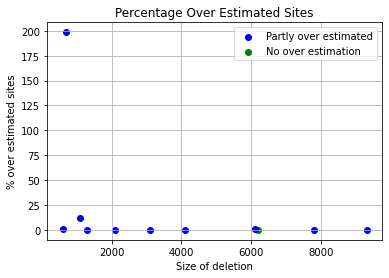

accuracy, sensitivity, specificity
(0.987434, 0.999811320754717, 0.9868859649122808)
[78.]
Sample:6, running time: 
10.935694932937622


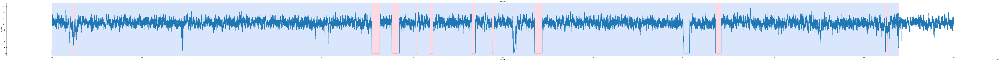

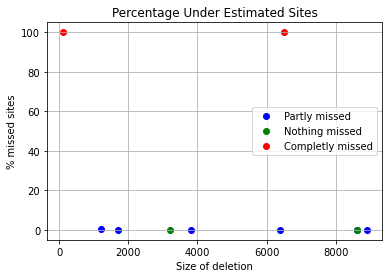

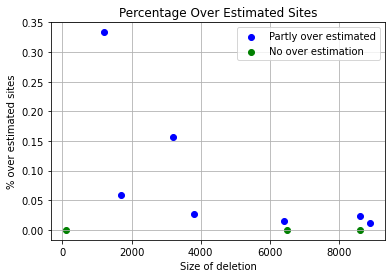

accuracy, sensitivity, specificity
(0.98666, 0.8651020408163266, 0.9929232386961093)
[78.]
Sample:7, running time: 
40.208247900009155


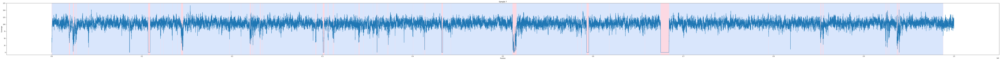

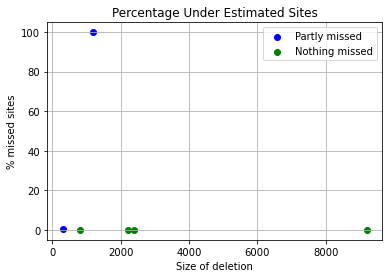

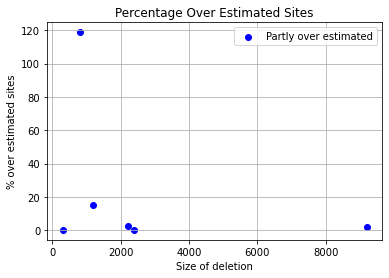

accuracy, sensitivity, specificity
(0.977823, 0.9999378881987577, 0.9774611240979775)


In [19]:
predict_deletions_window(path, "PA_chr01", 1, 1, 50, arr_avg_cov,[2], "bu_p1w50")


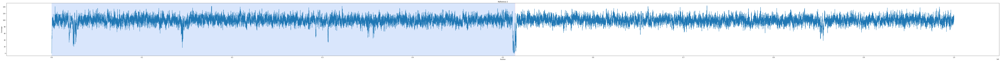

[78.]
Sample:3, running time: 
11.601288080215454


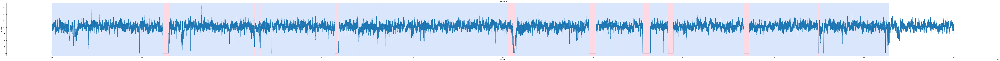

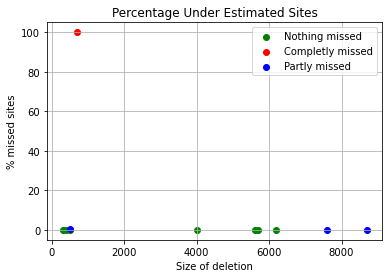

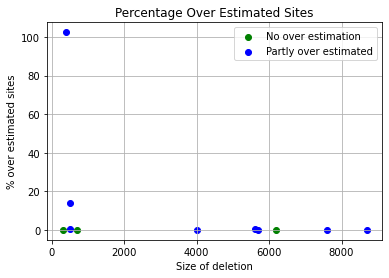

accuracy, sensitivity, specificity
(0.98229, 0.9824626865671642, 0.9822827672431756)
[78.]
Sample:4, running time: 
11.864578008651733


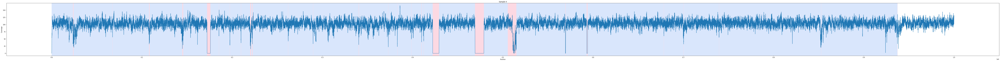

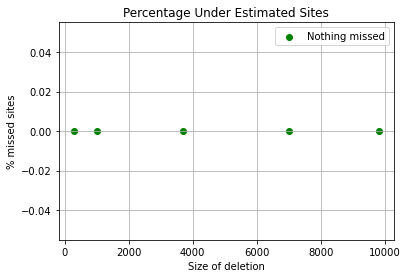

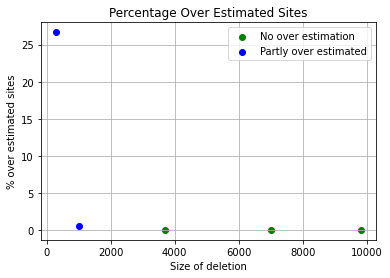

accuracy, sensitivity, specificity
(0.98338, 1.0, 0.9830096094868125)
[78.]
Sample:5, running time: 
12.229964017868042


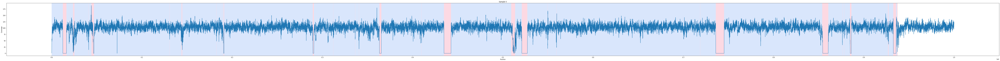

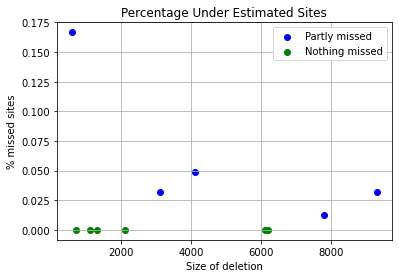

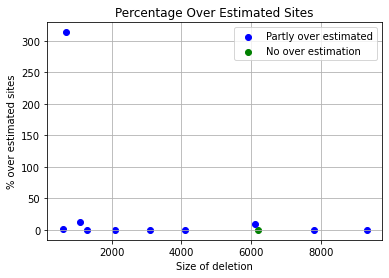

accuracy, sensitivity, specificity
(0.987204, 0.999811320754717, 0.9866457811194653)
[78.]
Sample:6, running time: 
10.934871912002563


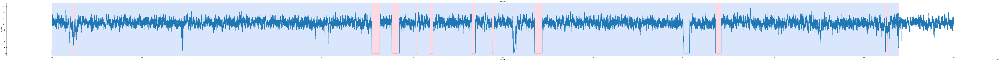

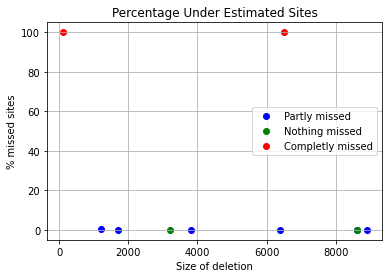

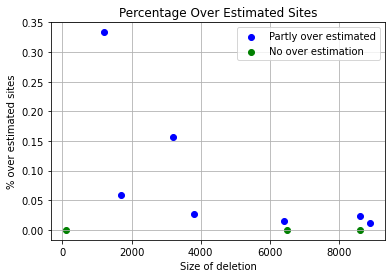

accuracy, sensitivity, specificity
(0.985915, 0.8651020408163266, 0.9921398527865405)
[78.]
Sample:7, running time: 
10.759676933288574


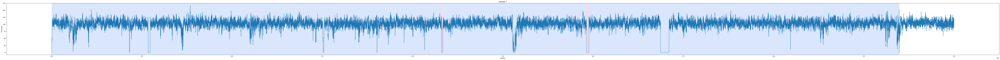

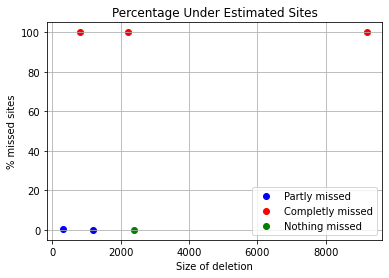

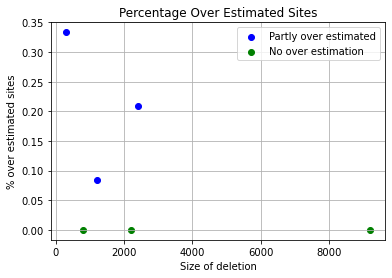

accuracy, sensitivity, specificity
(0.987216, 0.24211180124223602, 0.9994084764711861)


In [20]:
predict_deletions_window(path, "PA_chr01", 5, 5, 50, arr_avg_cov,[2], "w_p5w50")


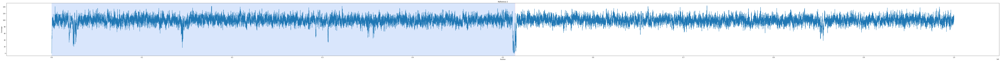

[78.]
Sample:3, running time: 
11.689265012741089


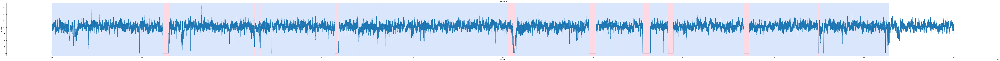

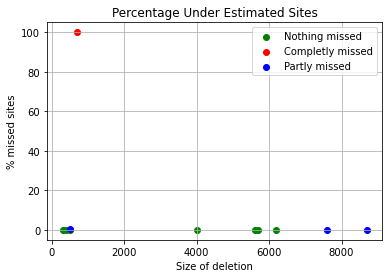

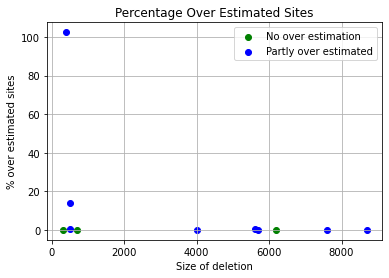

accuracy, sensitivity, specificity
(0.98229, 0.9824626865671642, 0.9822827672431756)
[78.]
Sample:4, running time: 
12.020127058029175


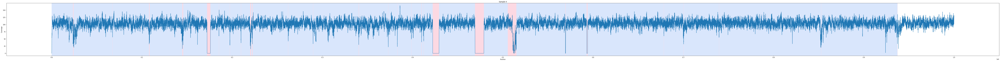

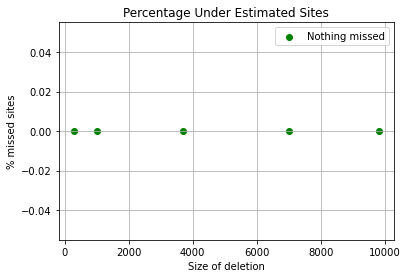

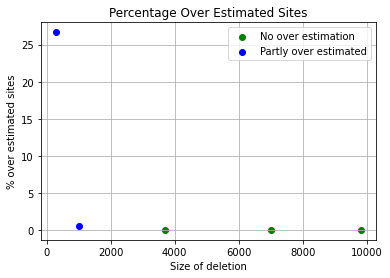

accuracy, sensitivity, specificity
(0.98338, 1.0, 0.9830096094868125)
[78.]
Sample:5, running time: 
12.308138847351074


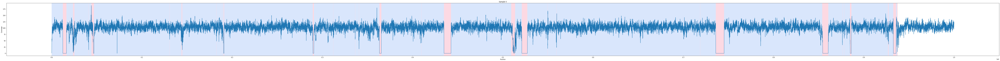

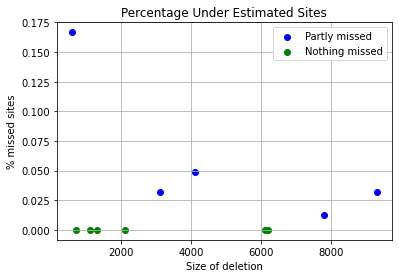

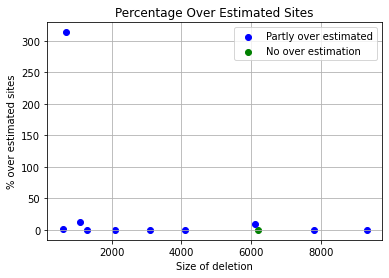

accuracy, sensitivity, specificity
(0.987204, 0.999811320754717, 0.9866457811194653)
[78.]
Sample:6, running time: 
10.89360785484314


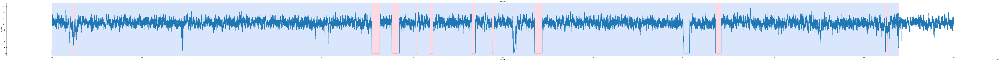

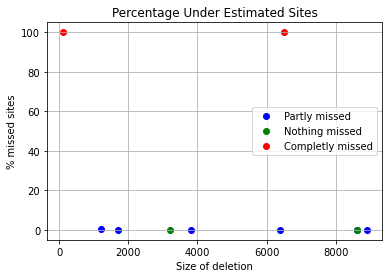

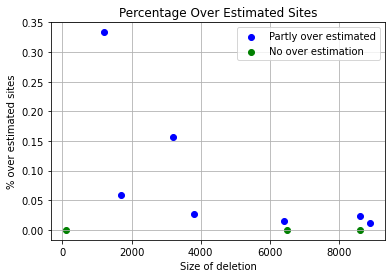

accuracy, sensitivity, specificity
(0.985915, 0.8651020408163266, 0.9921398527865405)
[78.]
Sample:7, running time: 
10.607167959213257


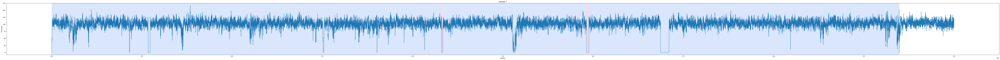

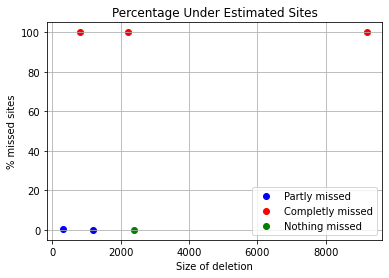

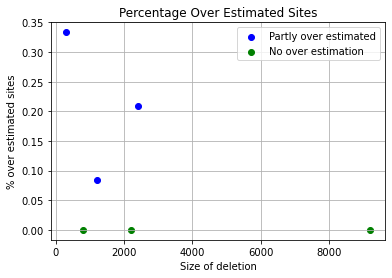

accuracy, sensitivity, specificity
(0.987216, 0.24211180124223602, 0.9994084764711861)


In [21]:
predict_deletions_window(path, "PA_chr01", 10, 10, 50, arr_avg_cov,[2], "w_p10w50")


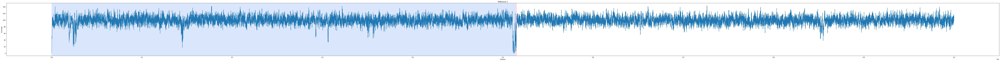

[78.]
Sample:3, running time: 
10.880033254623413


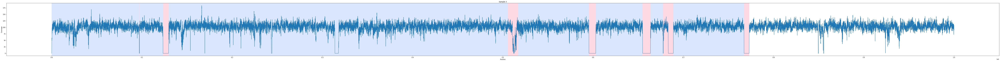

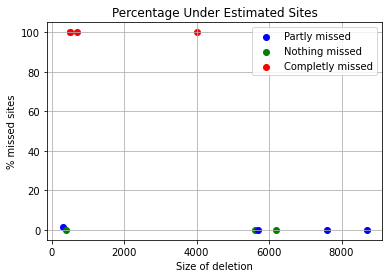

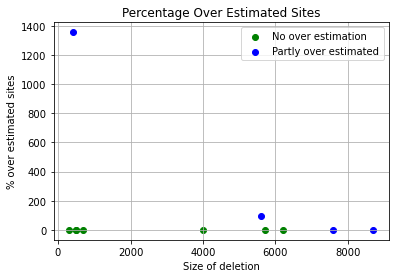

accuracy, sensitivity, specificity
(0.977126, 0.8579104477611941, 0.9821191914982288)
[78.]
Sample:4, running time: 
15.014915704727173


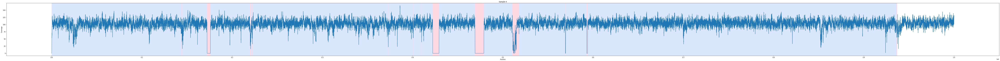

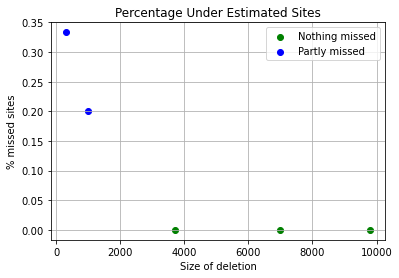

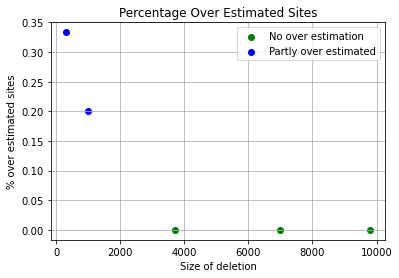

accuracy, sensitivity, specificity
(0.989209, 0.9998623853211009, 0.9889715804538949)
[78.]
Sample:5, running time: 
13.006793022155762


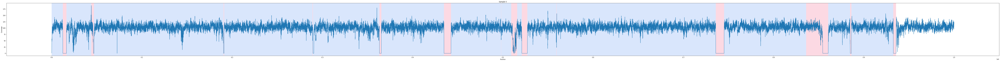

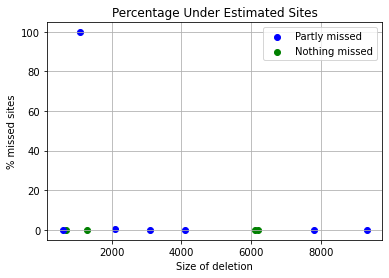

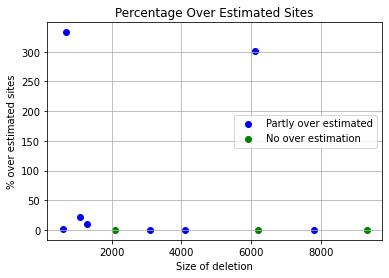

accuracy, sensitivity, specificity
(0.970526, 0.9737735849056603, 0.9703822055137845)
[78.]
Sample:6, running time: 
10.885956287384033


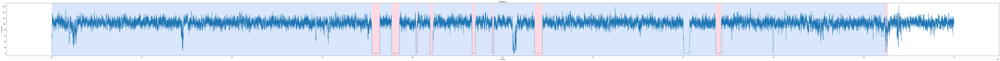

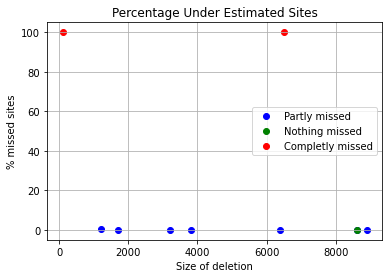

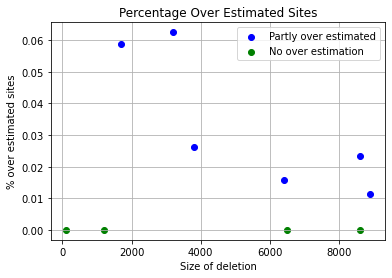

accuracy, sensitivity, specificity
(0.990764, 0.8650408163265306, 0.997241850683491)
[78.]
Sample:7, running time: 
11.562437057495117


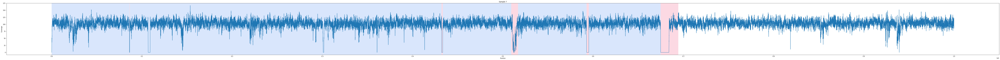

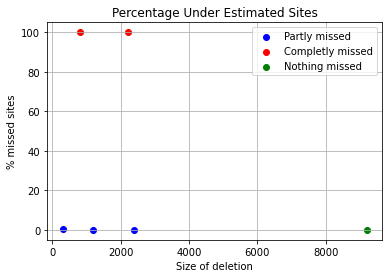

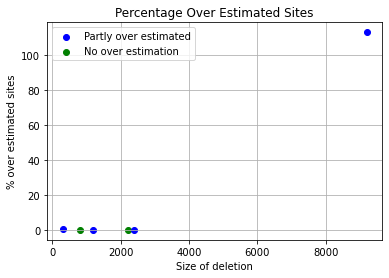

accuracy, sensitivity, specificity
(0.979062, 0.8134161490683229, 0.9817725378595386)


In [22]:
predict_deletions_window(path, "PA_chr01", 1, 1, 10, arr_avg_cov,[2], "w_p1w10")


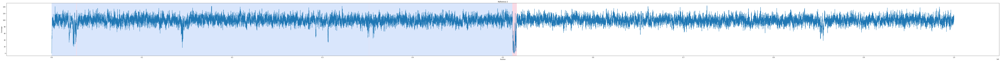

[78.]
Sample:3, running time: 
16.046061038970947


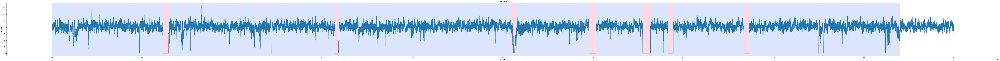

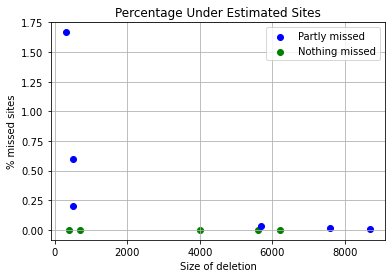

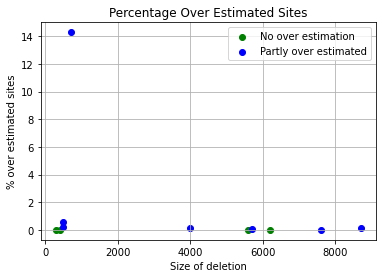

accuracy, sensitivity, specificity
(0.989019, 0.9996766169154229, 0.9885726192956866)
[78.]
Sample:4, running time: 
45.35107183456421


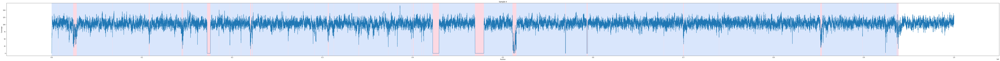

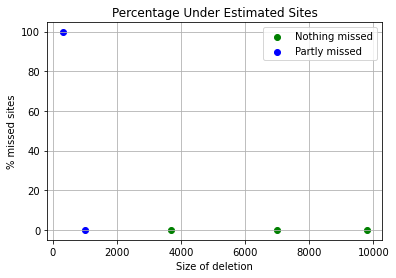

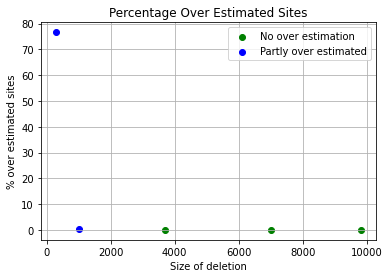

accuracy, sensitivity, specificity
(0.979366, 0.9999082568807339, 0.9789081987323656)
[78.]
Sample:5, running time: 
11.833303213119507


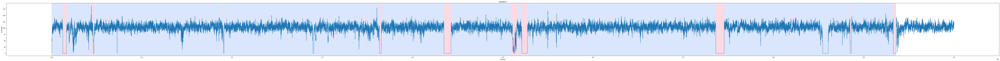

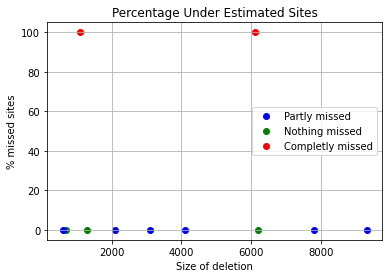

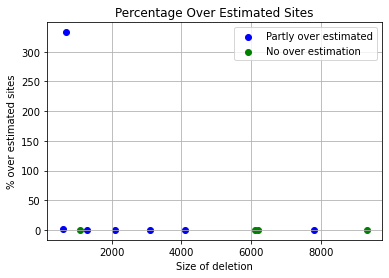

accuracy, sensitivity, specificity
(0.982774, 0.8298820754716981, 0.9895436507936508)
[78.]
Sample:6, running time: 
16.133330821990967


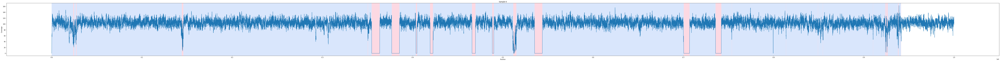

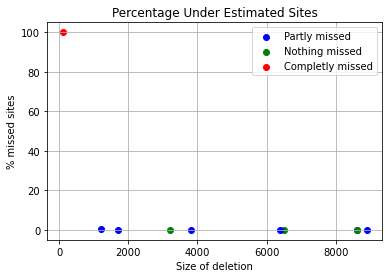

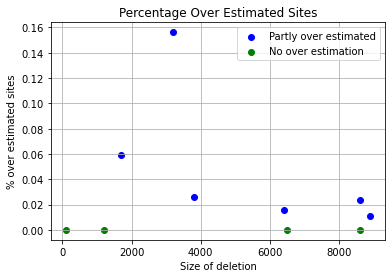

accuracy, sensitivity, specificity
(0.988873, 0.997734693877551, 0.988416403785489)
[78.]
Sample:7, running time: 
12.222745180130005


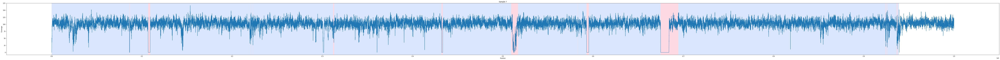

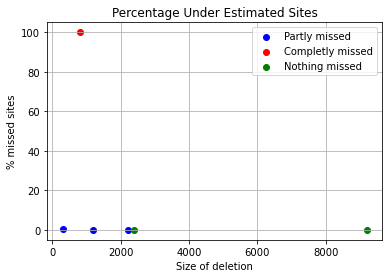

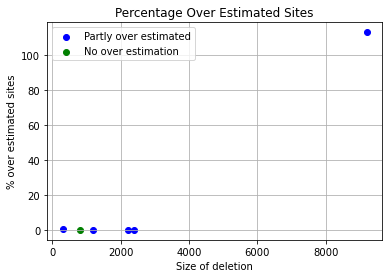

accuracy, sensitivity, specificity
(0.977919, 0.9501242236024845, 0.9783738184774875)


In [23]:
predict_deletions_window(path, "PA_chr01", 1, 1, 25, arr_avg_cov,[2], "w_p1w25")


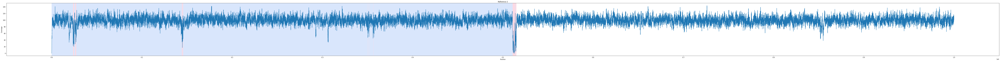

[78.]
Sample:3, running time: 
27.545222759246826


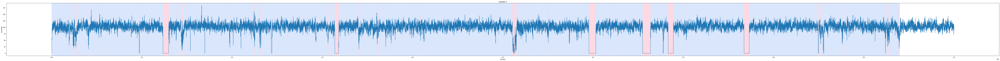

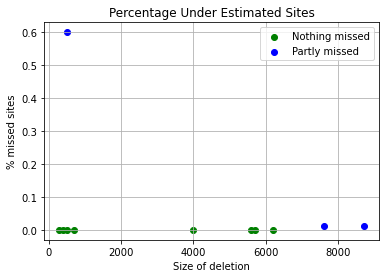

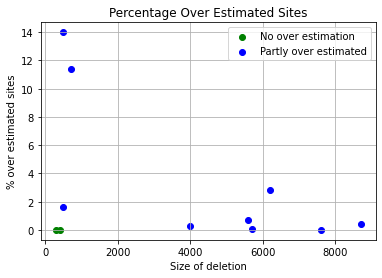

accuracy, sensitivity, specificity
(0.977195, 0.9998756218905472, 0.9762450510523025)
[78.]
Sample:4, running time: 
11.323179006576538


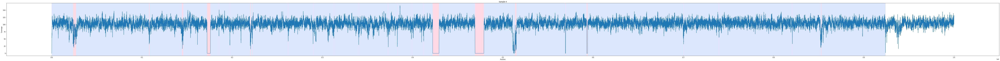

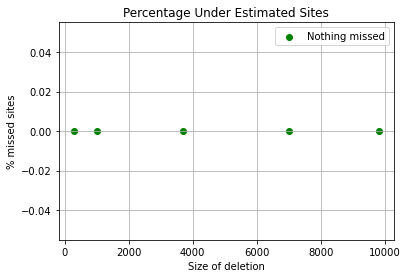

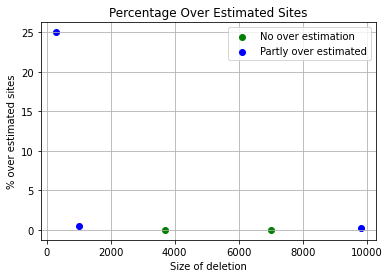

accuracy, sensitivity, specificity
(0.992, 1.0, 0.991821713351053)
[78.]
Sample:5, running time: 
14.023067951202393


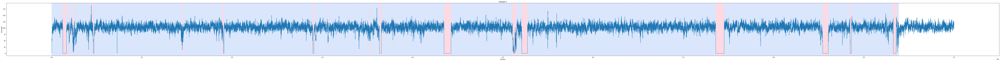

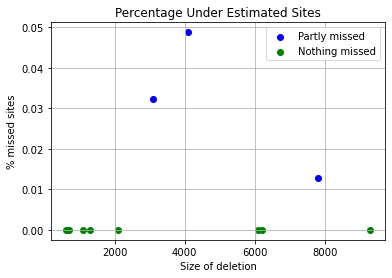

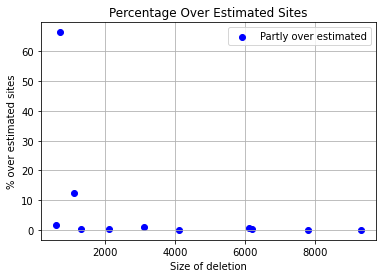

accuracy, sensitivity, specificity
(0.987307, 0.9999056603773585, 0.9867491645781119)
[78.]
Sample:6, running time: 
11.251415967941284


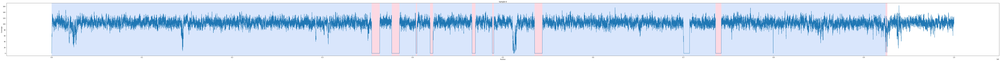

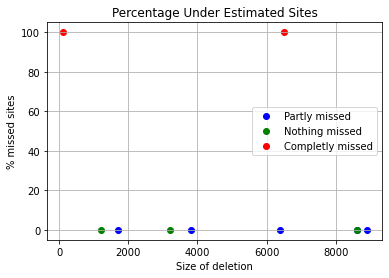

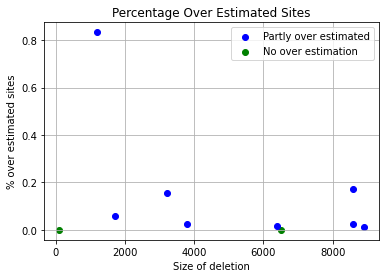

accuracy, sensitivity, specificity
(0.991353, 0.8651836734693877, 0.9978538380651946)
[78.]
Sample:7, running time: 
12.501106977462769


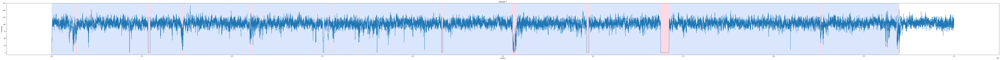

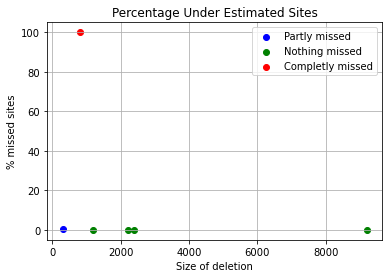

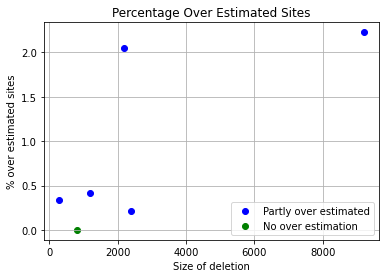

accuracy, sensitivity, specificity
(0.984823, 0.9502484472049689, 0.9853887590202256)


In [24]:
predict_deletions_window(path, "PA_chr01", 1, 1, 100, arr_avg_cov,[2], "w_p1w100")


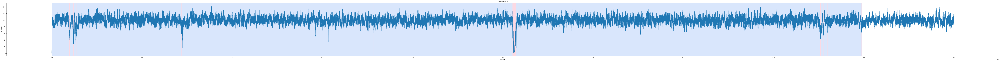

[78.]
Sample:3, running time: 
13.351114988327026


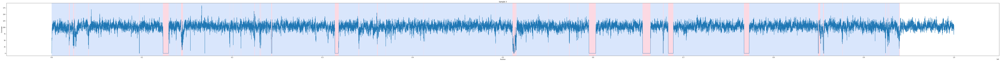

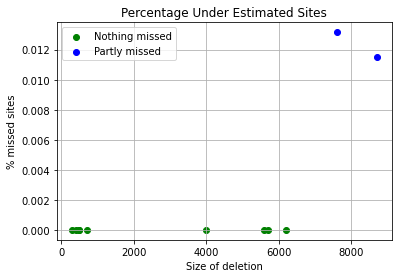

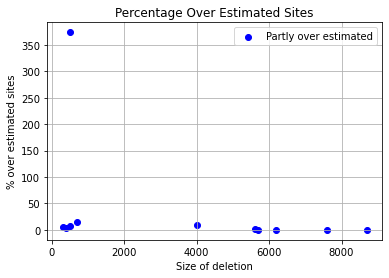

accuracy, sensitivity, specificity
(0.984941, 0.9999502487562189, 0.9843123567409877)
[78.]
Sample:4, running time: 
14.325883865356445


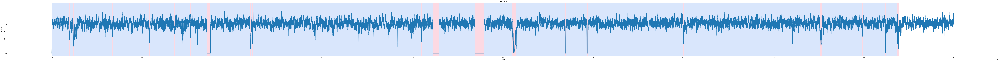

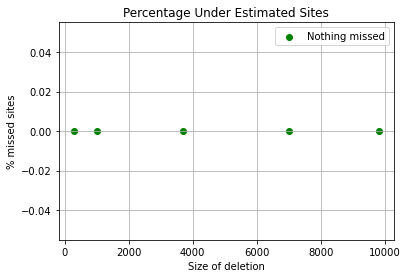

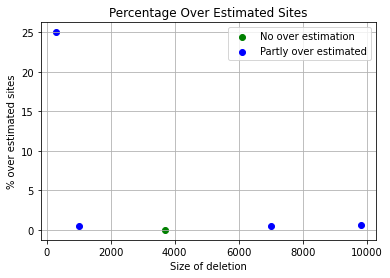

accuracy, sensitivity, specificity
(0.985685, 1.0, 0.9853659783275404)
[78.]
Sample:5, running time: 
26.392462015151978


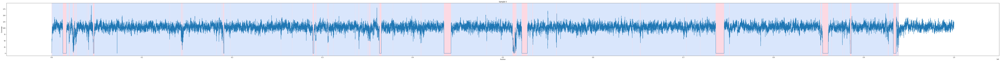

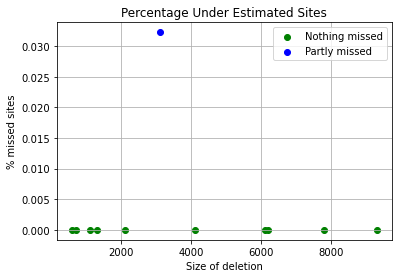

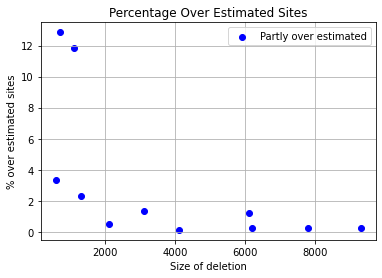

accuracy, sensitivity, specificity
(0.983238, 0.9999764150943397, 0.9824968671679198)
[78.]
Sample:6, running time: 
13.192783117294312


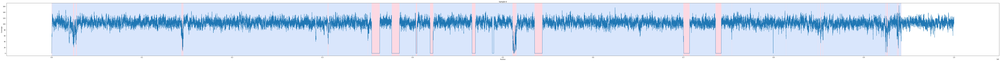

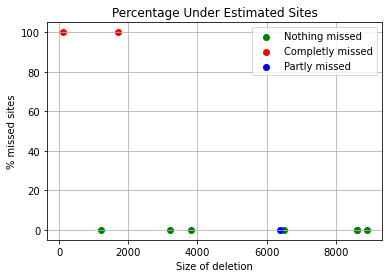

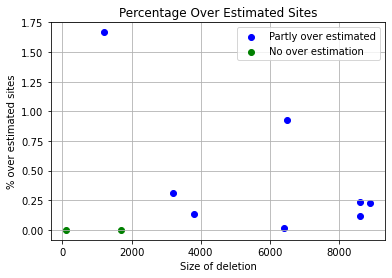

accuracy, sensitivity, specificity
(0.987208, 0.9632448979591837, 0.9884426919032597)
[78.]
Sample:7, running time: 
13.673364877700806


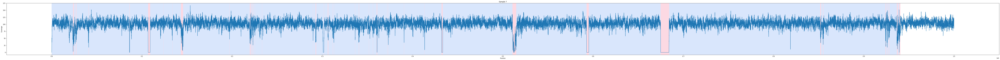

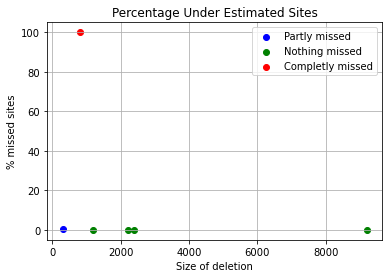

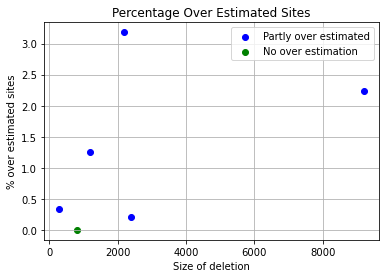

accuracy, sensitivity, specificity
(0.983678, 0.9502484472049689, 0.9842250228681777)


In [25]:
predict_deletions_window(path, "PA_chr01", 1, 1, 200, arr_avg_cov,[2], "w_p1w200")

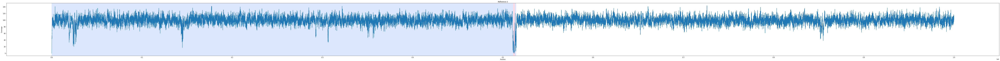

[15.6]
Sample:3, running time: 
25.886218070983887


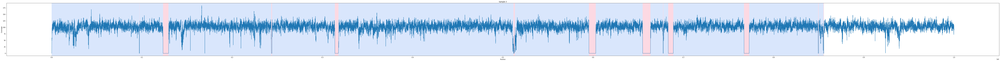

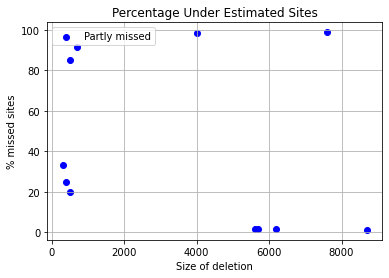

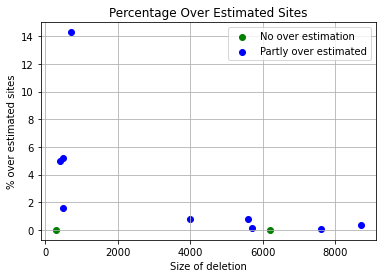

accuracy, sensitivity, specificity
(0.997948, 0.9906467661691543, 0.9982538028755991)
[15.6]
Sample:4, running time: 
20.495747089385986


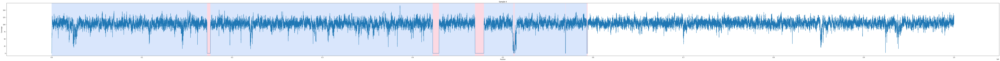

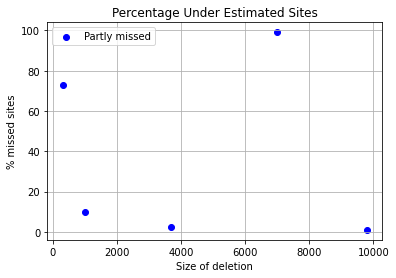

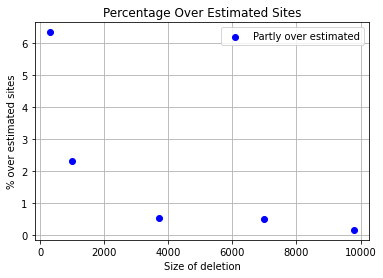

accuracy, sensitivity, specificity
(0.998476, 0.9948623853211009, 0.9985565324064608)
[15.6]
Sample:5, running time: 
25.956772089004517


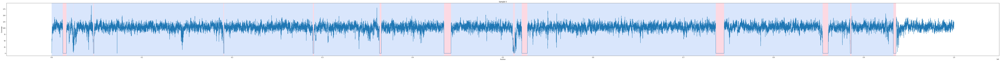

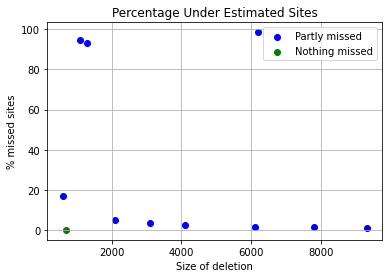

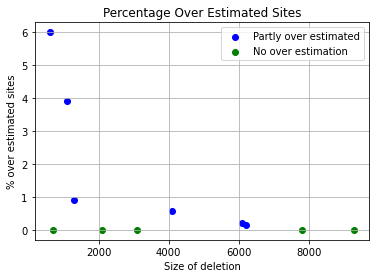

accuracy, sensitivity, specificity
(0.997926, 0.9873349056603774, 0.9983949456975773)
[15.6]
Sample:6, running time: 
26.02907705307007


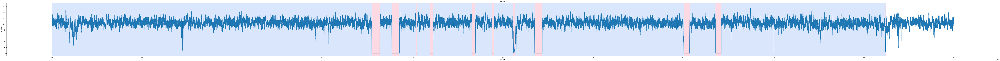

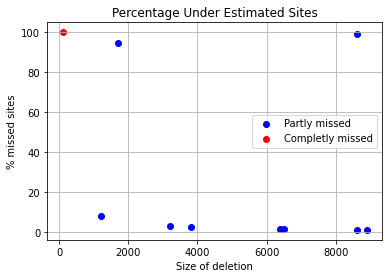

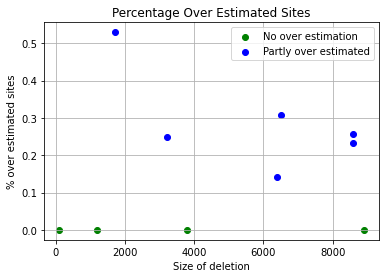

accuracy, sensitivity, specificity
(0.998024, 0.9900408163265306, 0.9984353312302839)
[15.6]
Sample:7, running time: 
20.525886058807373


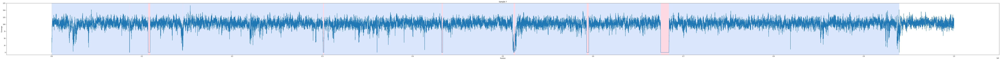

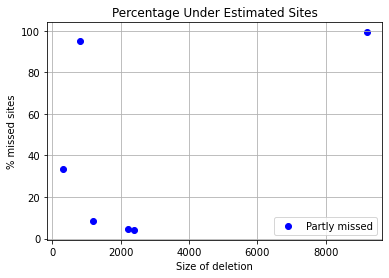

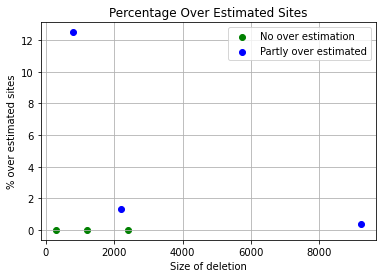

accuracy, sensitivity, specificity
(0.997672, 0.9773913043478261, 0.9980038621811159)


In [26]:
predict_deletions_pelt(path, "PA_chr01", 100, 100, 100, arr_avg_cov,[2], "pelt_p100")

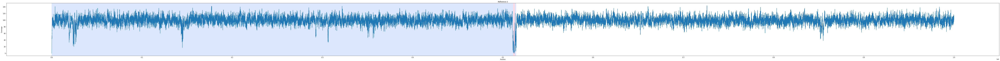

[15.6]
Sample:3, running time: 
22.17268991470337


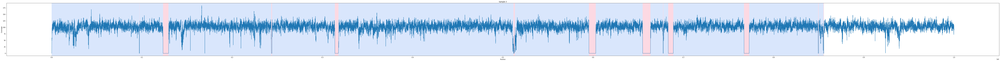

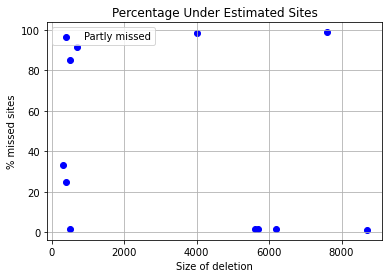

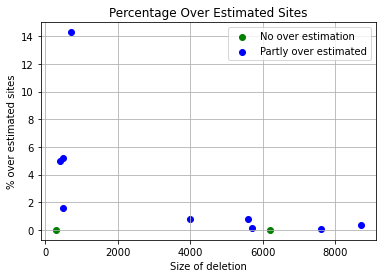

accuracy, sensitivity, specificity
(0.997948, 0.9906467661691543, 0.9982538028755991)
[15.6]
Sample:4, running time: 
18.75571084022522


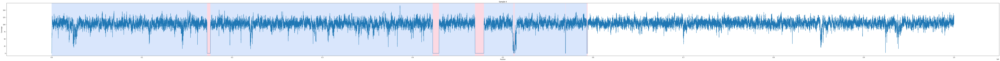

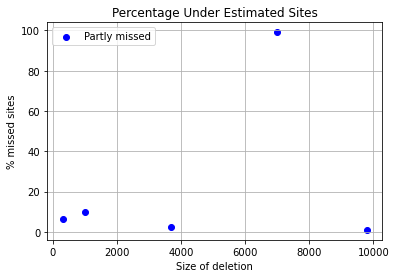

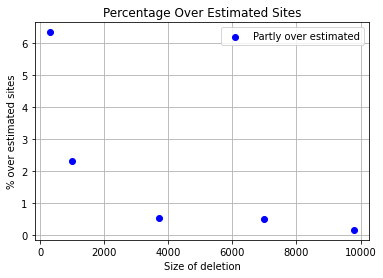

accuracy, sensitivity, specificity
(0.998676, 0.9948623853211009, 0.9987609895726846)
[15.6]
Sample:5, running time: 
22.50140905380249


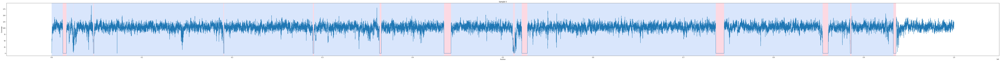

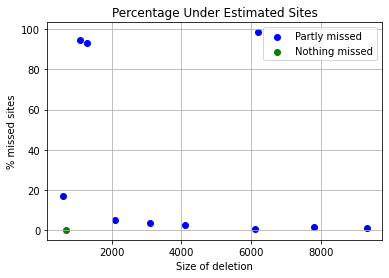

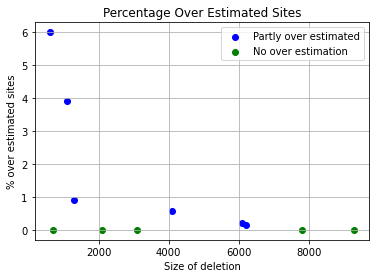

accuracy, sensitivity, specificity
(0.998226, 0.9873349056603774, 0.9987082289055973)
[15.6]
Sample:6, running time: 
22.47056794166565


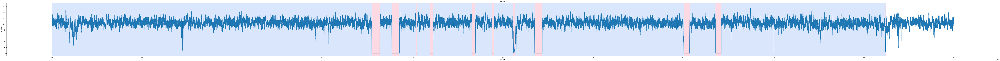

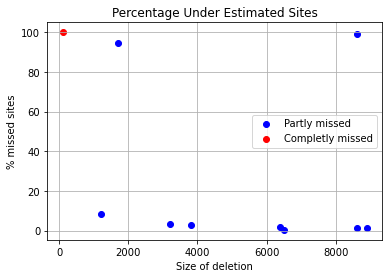

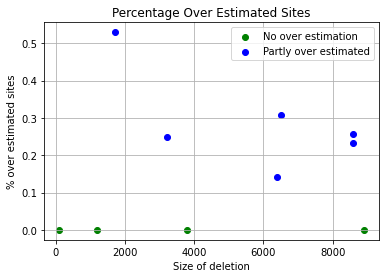

accuracy, sensitivity, specificity
(0.998024, 0.9900408163265306, 0.9984353312302839)
[15.6]
Sample:7, running time: 
18.43315291404724


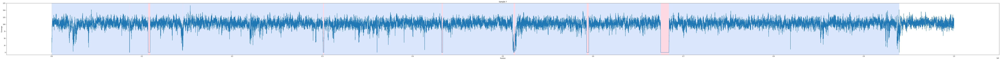

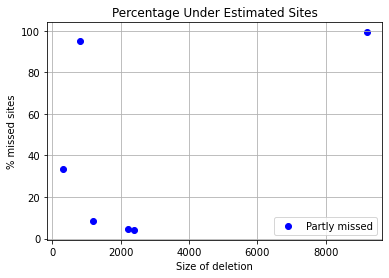

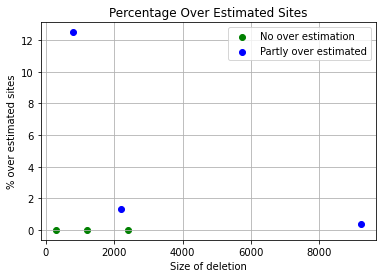

accuracy, sensitivity, specificity
(0.997672, 0.9773913043478261, 0.9980038621811159)


In [27]:
predict_deletions_pelt(path, "PA_chr01", 1000, 1000, 100, arr_avg_cov,[2], "pelt_p1000")

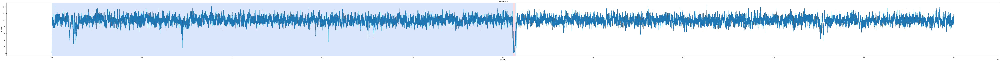

[15.6]
Sample:3, running time: 
16.328760862350464


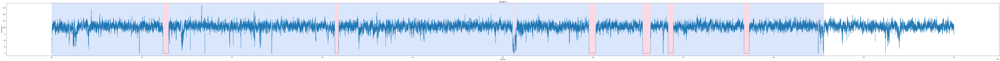

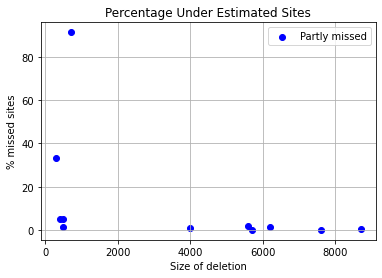

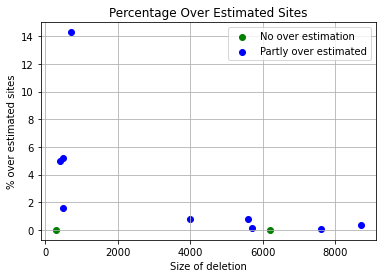

accuracy, sensitivity, specificity
(0.999148, 0.9906467661691543, 0.9995040633465305)
[15.6]
Sample:4, running time: 
15.3369779586792


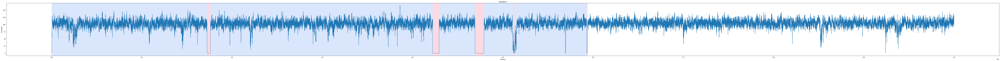

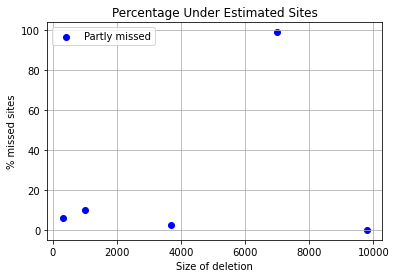

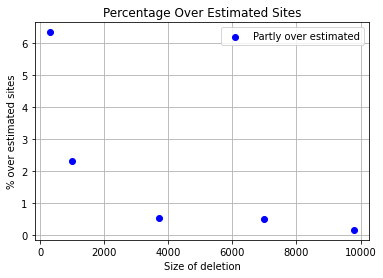

accuracy, sensitivity, specificity
(0.999576, 0.9948623853211009, 0.999681046820691)
[15.6]
Sample:5, running time: 
16.38908314704895


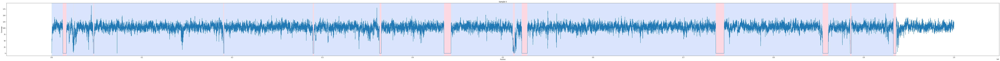

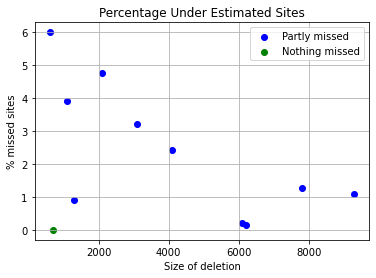

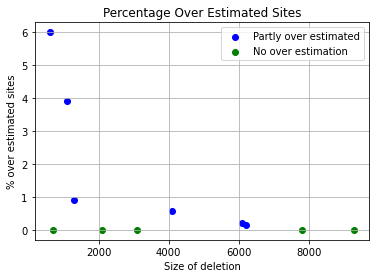

accuracy, sensitivity, specificity
(0.999226, 0.9873349056603774, 0.9997525062656641)
[15.6]
Sample:6, running time: 
14.899211883544922


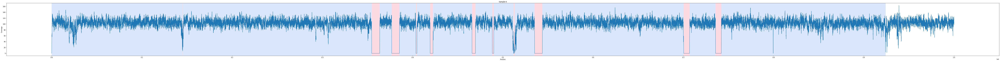

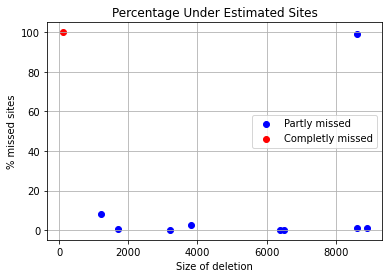

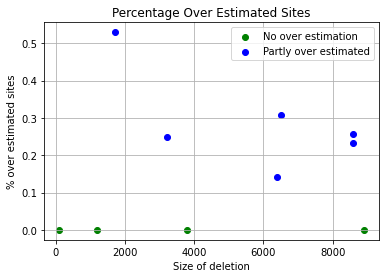

accuracy, sensitivity, specificity
(0.998024, 0.9900408163265306, 0.9984353312302839)
[15.6]
Sample:7, running time: 
14.898175954818726


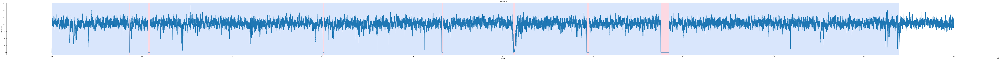

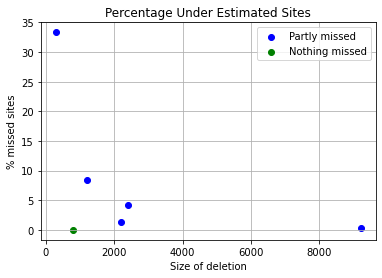

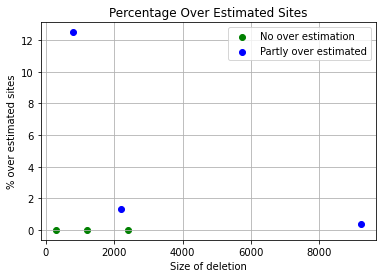

accuracy, sensitivity, specificity
(0.998672, 0.9773913043478261, 0.9990202256326862)


In [28]:
predict_deletions_pelt(path, "PA_chr01", 10000, 10000, 100, arr_avg_cov,[2], "pelt_p10000")

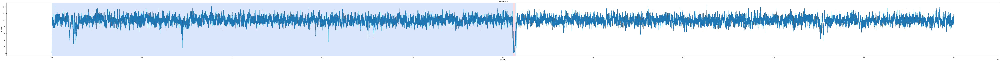

[15.6]
Sample:3, running time: 
16.623203992843628


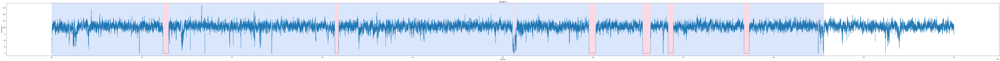

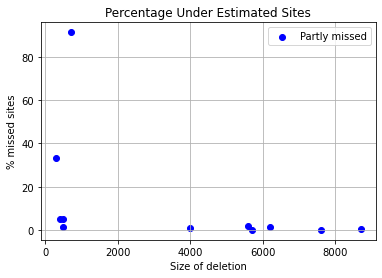

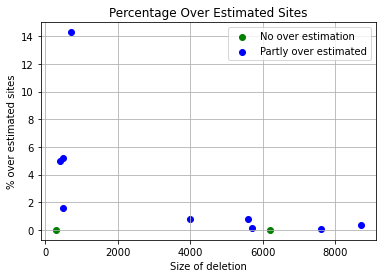

accuracy, sensitivity, specificity
(0.999148, 0.9906467661691543, 0.9995040633465305)
[15.6]
Sample:4, running time: 
16.270932912826538


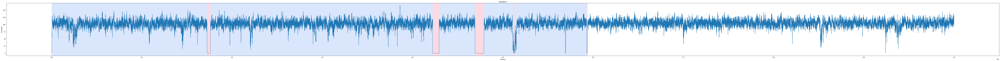

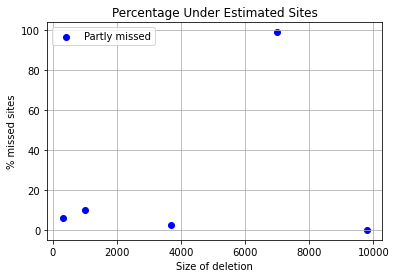

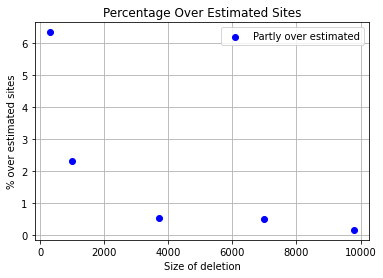

accuracy, sensitivity, specificity
(0.999576, 0.9948623853211009, 0.999681046820691)
[15.6]
Sample:5, running time: 
16.207767963409424


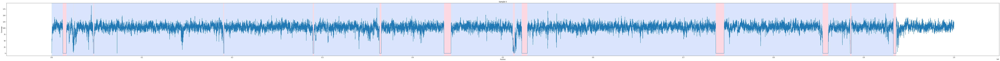

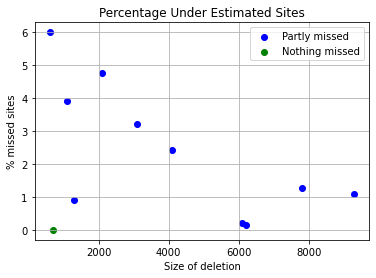

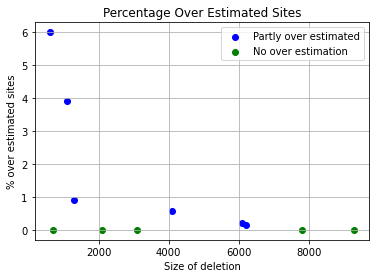

accuracy, sensitivity, specificity
(0.999226, 0.9873349056603774, 0.9997525062656641)
[15.6]
Sample:6, running time: 
15.386883735656738


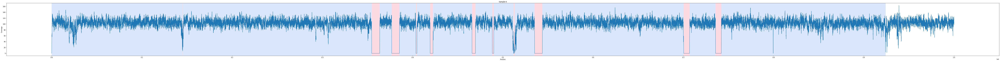

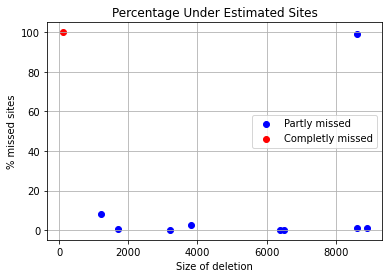

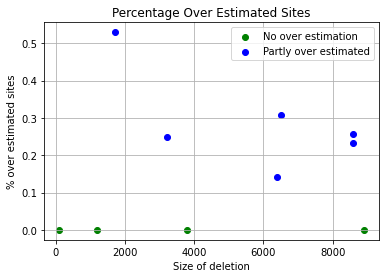

accuracy, sensitivity, specificity
(0.998024, 0.9900408163265306, 0.9984353312302839)
[15.6]
Sample:7, running time: 
15.131673097610474


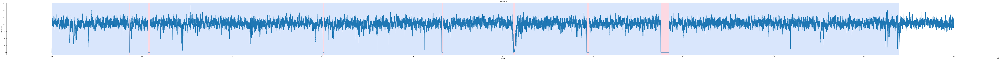

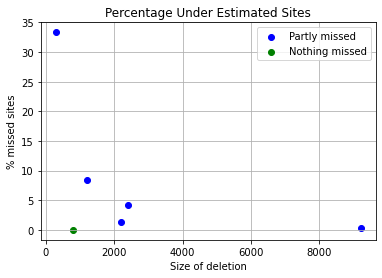

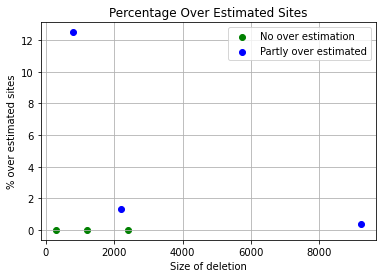

accuracy, sensitivity, specificity
(0.998672, 0.9773913043478261, 0.9990202256326862)


In [29]:
predict_deletions_pelt(path, "PA_chr01", 10**4, 10**4, 100, arr_avg_cov,[2], "pelt_p10e4")

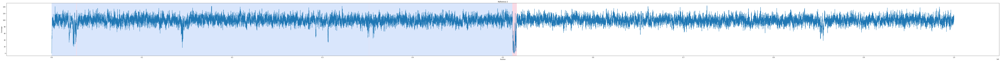

[78.]
Sample:3, running time: 
17.395827054977417


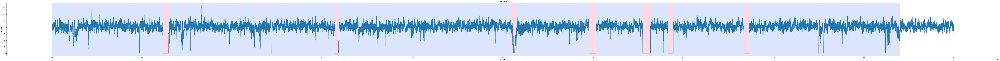

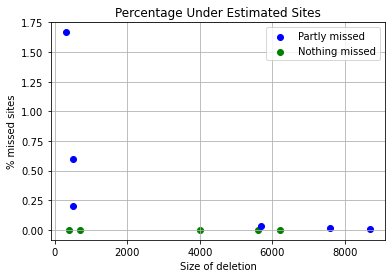

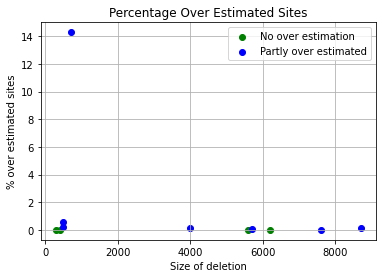

accuracy, sensitivity, specificity
(0.989019, 0.9996766169154229, 0.9885726192956866)
[78.]
Sample:4, running time: 
49.520527839660645


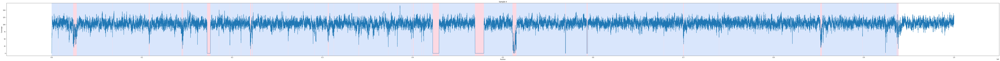

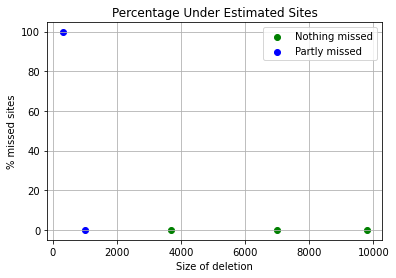

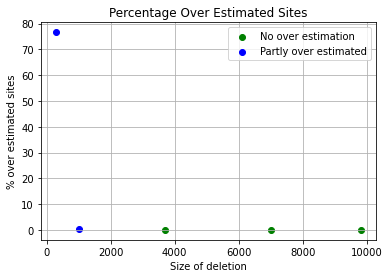

accuracy, sensitivity, specificity
(0.979366, 0.9999082568807339, 0.9789081987323656)
[78.]
Sample:5, running time: 
13.300953149795532


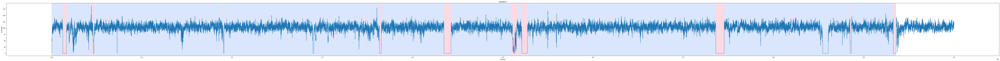

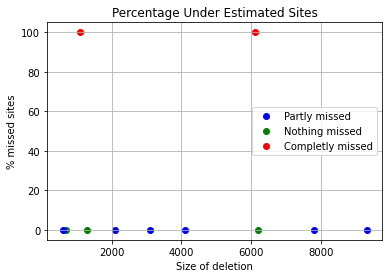

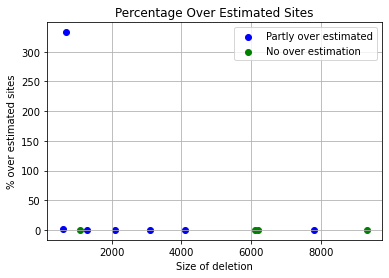

accuracy, sensitivity, specificity
(0.982774, 0.8298820754716981, 0.9895436507936508)
[78.]
Sample:6, running time: 
31.397310972213745


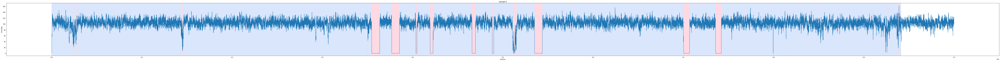

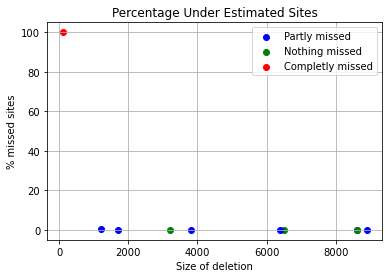

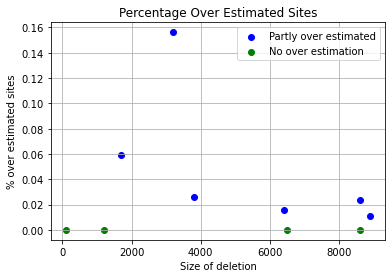

accuracy, sensitivity, specificity
(0.988803, 0.997734693877551, 0.9883427970557308)
[78.]
Sample:7, running time: 
13.669457912445068


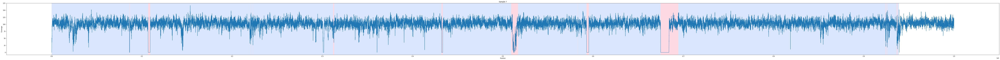

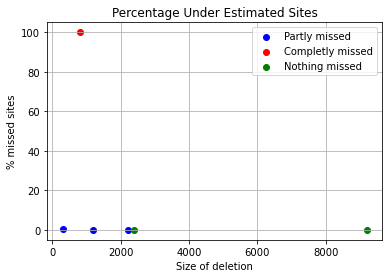

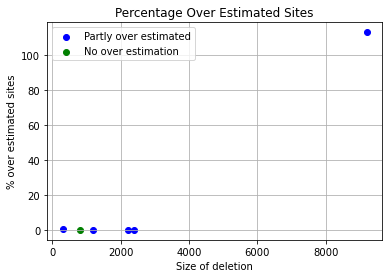

accuracy, sensitivity, specificity
(0.977919, 0.9501242236024845, 0.9783738184774875)


In [30]:
predict_deletions_window(path, "PA_chr01", 0.5, 0.5, 25, arr_avg_cov,[2], "w_p05")